# Data Loading

In [1]:
import sys
sys.path.insert(0, '..')

In [2]:
# imports
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from processing_utils.feature_data_from_mat import load_subject_high_gamma

In [3]:
sig = True
zscore = False
cluster = False
data_dir = '../data/'

In [4]:
phon_labels = ['a', 'ae', 'i', 'u', 'b', 'p', 'v', 'g', 'k']
artic_labels = ['low', 'high', 'labial', 'dorsal']
phon_to_artic_dict = {1:1, 2:1, 3:2, 4:2, 5:3, 6:3, 7:3, 8:4, 9:4}

In [5]:
def phon_to_artic(phon_idx, phon_to_artic_conv):
    return phon_to_artic_conv[phon_idx]

def phon_to_artic_seq(phon_seq, phon_to_artic_conv):
    flat_seq = phon_seq.flatten()
    artic_conv = np.array([phon_to_artic(phon_idx, phon_to_artic_conv) for phon_idx in flat_seq])
    return np.reshape(artic_conv, phon_seq.shape)

def labels2cv_seq(labels):
    labels_str = []
    for i in range(labels.shape[0]):
        middle_label = labels[i, 1]
        if middle_label < 5: # middle phoneme if vowel if 1-4 thus cvc
            labels_str.append('cvc')
        else:  
            labels_str.append('vcv')
    return np.array(labels_str)

### Relative to Response Onset

Load in S14 Data

In [6]:
S14_hg_trace, S14_hg_map, S14_phon_labels = load_subject_high_gamma('S14', sig_channel=sig, zscore=zscore, cluster=cluster, data_dir=data_dir)

(144, 200, 111)
(144, 8, 16, 200)
(144, 3)


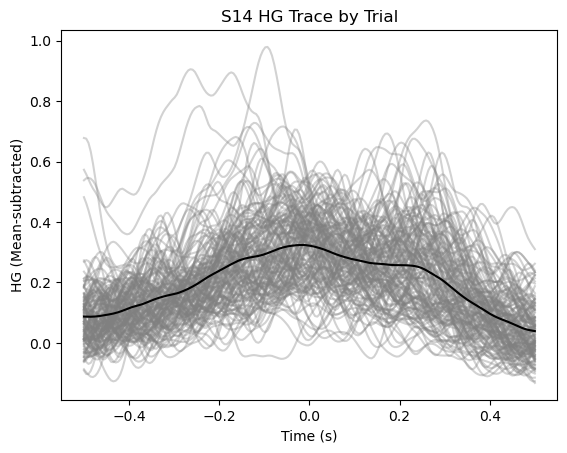

In [7]:
print(S14_hg_trace.shape)
print(S14_hg_map.shape)
print(S14_phon_labels.shape)

plt.figure()
plt.plot(np.linspace(-0.5, 0.5, 200), np.mean(S14_hg_trace, axis=2).T, 'grey', alpha=0.35)
plt.plot(np.linspace(-0.5, 0.5, 200), np.mean(np.mean(S14_hg_trace, axis=2), axis=0), 'black')
plt.xlabel('Time (s)')
plt.ylabel('HG (Mean-subtracted)')
plt.title('S14 HG Trace by Trial')
plt.show()

Load in S26 Data

In [8]:
S26_hg_trace, S26_hg_map, S26_phon_labels = load_subject_high_gamma('S26', sig_channel=sig, zscore=zscore, cluster=cluster, data_dir=data_dir)

(148, 200, 111)
(148, 8, 16, 200)
(148, 3)


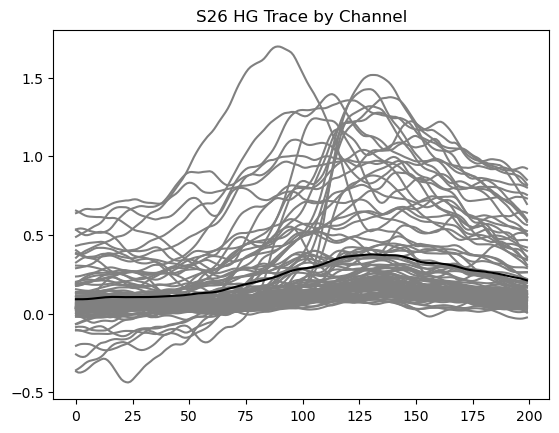

In [9]:
print(S26_hg_trace.shape)
print(S26_hg_map.shape)
print(S26_phon_labels.shape)

plt.figure()
plt.plot(np.mean(S26_hg_trace, axis=0), 'grey')
plt.plot(np.mean(np.mean(S26_hg_trace, axis=0), axis=1), 'black')
plt.title('S26 HG Trace by Channel')
plt.show()

Load in S23 Data

In [10]:
S23_hg_trace, S23_hg_map, S23_phon_labels = load_subject_high_gamma('S23', sig_channel=sig, zscore=zscore, cluster=cluster, data_dir=data_dir)

(151, 200, 63)
(151, 8, 16, 200)
(151, 3)


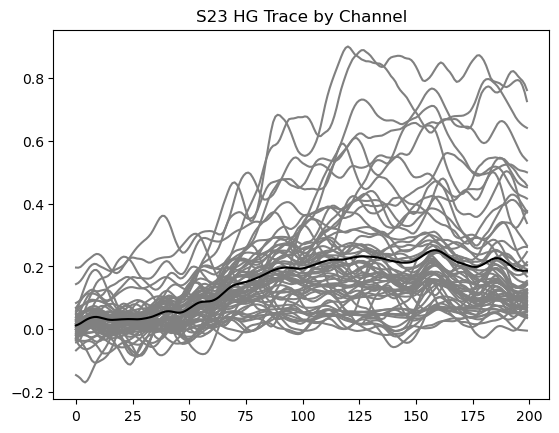

In [11]:
print(S23_hg_trace.shape)
print(S23_hg_map.shape)
print(S23_phon_labels.shape)

plt.figure()
plt.plot(np.mean(S23_hg_trace, axis=0), 'grey')
plt.plot(np.mean(np.mean(S23_hg_trace, axis=0), axis=1), 'black')
plt.title('S23 HG Trace by Channel')
plt.show()

Load in S33 Data

In [12]:
S33_hg_trace, S33_hg_map, S33_phon_labels = load_subject_high_gamma('S33', sig_channel=sig, zscore=zscore, cluster=cluster, data_dir=data_dir)

(46, 200, 149)
(46, 12, 24, 200)
(46, 3)


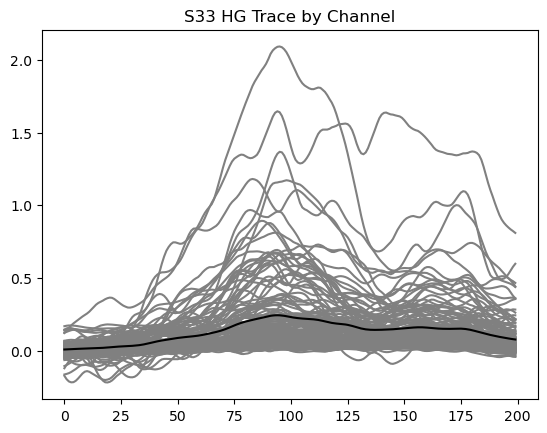

In [13]:
print(S33_hg_trace.shape)
print(S33_hg_map.shape)
print(S33_phon_labels.shape)

plt.figure()
plt.plot(np.mean(S33_hg_trace, axis=0), 'grey')
plt.plot(np.mean(np.mean(S33_hg_trace, axis=0), axis=1), 'black')
plt.title('S33 HG Trace by Channel')
plt.show()

### Relative to Different Phoneme Onsets

In [14]:
from processing_utils.feature_data_from_mat import load_subject_high_gamma_phoneme

S14 Data

In [15]:
S14_hg_data = load_subject_high_gamma_phoneme('S14', phons=[1, 2, 3], cluster=cluster, zscore=zscore, data_dir=data_dir)

(144, 200, 111) (144, 200, 111) (144, 200, 111)
(144, 8, 16, 200) (144, 8, 16, 200) (144, 8, 16, 200)
(144,) (144,) (144,) (144, 3)


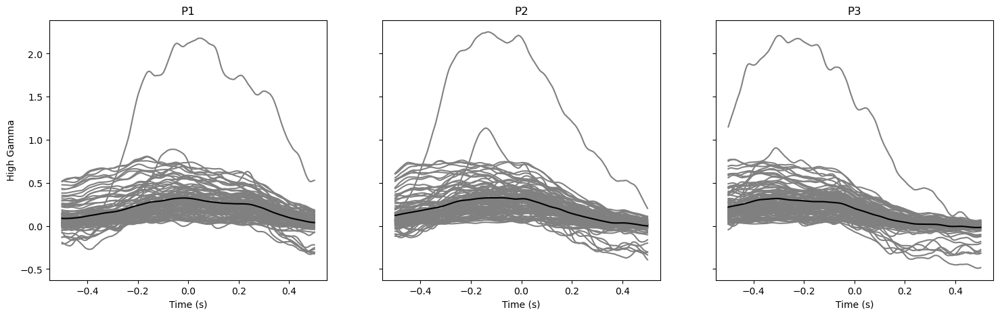

In [16]:
print(S14_hg_data['X1'].shape, S14_hg_data['X2'].shape, S14_hg_data['X3'].shape)
print(S14_hg_data['X1_map'].shape, S14_hg_data['X2_map'].shape, S14_hg_data['X3_map'].shape)
print(S14_hg_data['y1'].shape, S14_hg_data['y2'].shape, S14_hg_data['y3'].shape, S14_hg_data['y_full_phon'].shape)

t = np.linspace(-0.5, 0.5, S14_hg_data['X1'].shape[1])
f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, figsize=(18, 5))
ax1.plot(t, np.mean(S14_hg_data['X1'], axis=0), 'grey')
ax1.plot(t, np.mean(np.mean(S14_hg_data['X1'], axis=0), axis=1), 'black')
ax1.set_title('P1')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('High Gamma')

ax2.plot(t, np.mean(S14_hg_data['X2'], axis=0), 'grey')
ax2.plot(t, np.mean(np.mean(S14_hg_data['X2'], axis=0), axis=1), 'black')
ax2.set_title('P2')
ax2.set_xlabel('Time (s)')
# ax2.set_ylabel('High Gamma')

ax3.plot(t, np.mean(S14_hg_data['X3'], axis=0), 'grey')
ax3.plot(t, np.mean(np.mean(S14_hg_data['X3'], axis=0), axis=1), 'black')
ax3.set_title('P3')
ax3.set_xlabel('Time (s)')
# ax3.set_ylabel('High Gamma')

plt.show()

S26 data

In [17]:
S26_hg_data = load_subject_high_gamma_phoneme('S26', phons=[1, 2, 3], cluster=cluster, zscore=zscore, data_dir=data_dir)

(148, 200, 111) (148, 200, 111) (148, 200, 111)
(148, 8, 16, 200) (148, 8, 16, 200) (148, 8, 16, 200)
(148,) (148,) (148,) (148, 3)


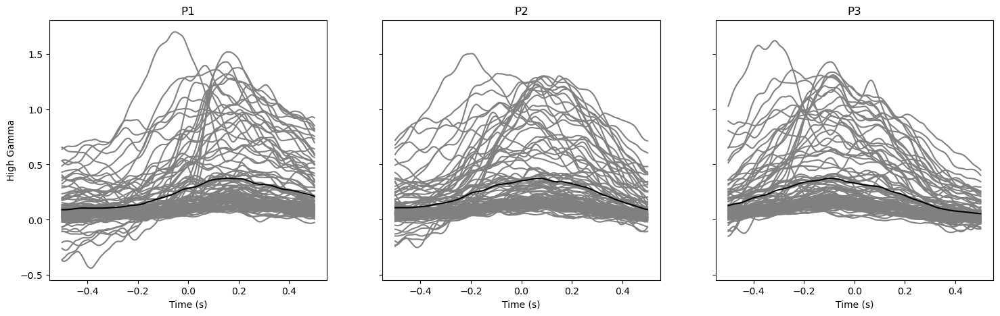

In [18]:
print(S26_hg_data['X1'].shape, S26_hg_data['X2'].shape, S26_hg_data['X3'].shape)
print(S26_hg_data['X1_map'].shape, S26_hg_data['X2_map'].shape, S26_hg_data['X3_map'].shape)
print(S26_hg_data['y1'].shape, S26_hg_data['y2'].shape, S26_hg_data['y3'].shape, S26_hg_data['y_full_phon'].shape)

t = np.linspace(-0.5, 0.5, S26_hg_data['X1'].shape[1])
f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, figsize=(18, 5))
ax1.plot(t, np.mean(S26_hg_data['X1'], axis=0), 'grey')
ax1.plot(t, np.mean(np.mean(S26_hg_data['X1'], axis=0), axis=1), 'black')
ax1.set_title('P1')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('High Gamma')

ax2.plot(t, np.mean(S26_hg_data['X2'], axis=0), 'grey')
ax2.plot(t, np.mean(np.mean(S26_hg_data['X2'], axis=0), axis=1), 'black')
ax2.set_title('P2')
ax2.set_xlabel('Time (s)')
# ax2.set_ylabel('High Gamma')

ax3.plot(t, np.mean(S26_hg_data['X3'], axis=0), 'grey')
ax3.plot(t, np.mean(np.mean(S26_hg_data['X3'], axis=0), axis=1), 'black')
ax3.set_title('P3')
ax3.set_xlabel('Time (s)')
# ax3.set_ylabel('High Gamma')

plt.show()


S23 Data

In [19]:
S23_hg_data = load_subject_high_gamma_phoneme('S23', phons=[1, 2, 3], cluster=cluster, zscore=zscore, data_dir=data_dir)

(151, 200, 63) (151, 200, 63) (151, 200, 63)
(151, 8, 16, 200) (151, 8, 16, 200) (151, 8, 16, 200)
(151,) (151,) (151,) (151, 3)


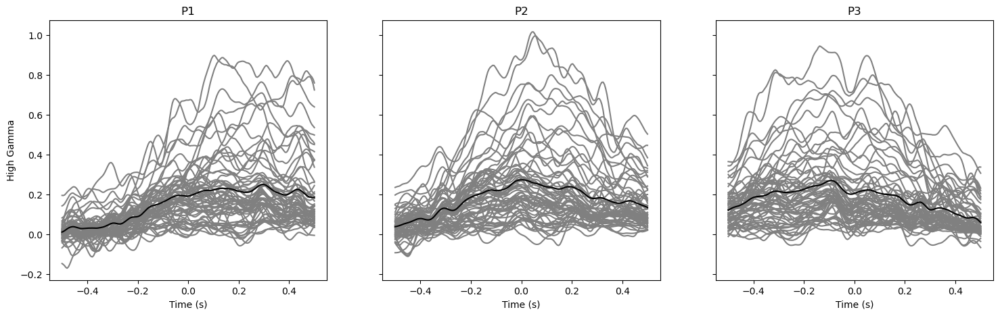

In [20]:
print(S23_hg_data['X1'].shape, S23_hg_data['X2'].shape, S23_hg_data['X3'].shape)
print(S23_hg_data['X1_map'].shape, S23_hg_data['X2_map'].shape, S23_hg_data['X3_map'].shape)
print(S23_hg_data['y1'].shape, S23_hg_data['y2'].shape, S23_hg_data['y3'].shape, S23_hg_data['y_full_phon'].shape)

t = np.linspace(-0.5, 0.5, S23_hg_data['X1'].shape[1])
f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, figsize=(18, 5))
ax1.plot(t, np.mean(S23_hg_data['X1'], axis=0), 'grey')
ax1.plot(t, np.mean(np.mean(S23_hg_data['X1'], axis=0), axis=1), 'black')
ax1.set_title('P1')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('High Gamma')

ax2.plot(t, np.mean(S23_hg_data['X2'], axis=0), 'grey')
ax2.plot(t, np.mean(np.mean(S23_hg_data['X2'], axis=0), axis=1), 'black')
ax2.set_title('P2')
ax2.set_xlabel('Time (s)')
# ax2.set_ylabel('High Gamma')

ax3.plot(t, np.mean(S23_hg_data['X3'], axis=0), 'grey')
ax3.plot(t, np.mean(np.mean(S23_hg_data['X3'], axis=0), axis=1), 'black')
ax3.set_title('P3')
ax3.set_xlabel('Time (s)')
# ax3.set_ylabel('High Gamma')

plt.show()

S33 Data

In [21]:
S33_hg_data = load_subject_high_gamma_phoneme('S33', phons=[1, 2, 3], cluster=cluster, zscore=zscore, data_dir=data_dir)

(46, 200, 149) (46, 200, 149) (46, 200, 149)
(46, 12, 24, 200) (46, 12, 24, 200) (46, 12, 24, 200)
(46,) (46,) (46,) (46, 3)


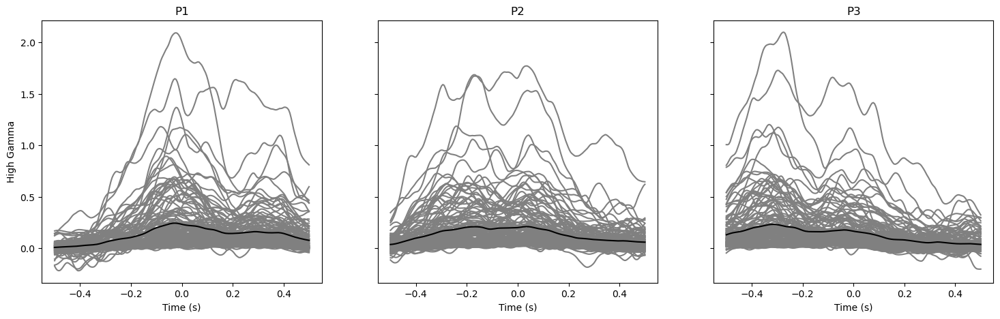

In [22]:
print(S33_hg_data['X1'].shape, S33_hg_data['X2'].shape, S33_hg_data['X3'].shape)
print(S33_hg_data['X1_map'].shape, S33_hg_data['X2_map'].shape, S33_hg_data['X3_map'].shape)
print(S33_hg_data['y1'].shape, S33_hg_data['y2'].shape, S33_hg_data['y3'].shape, S33_hg_data['y_full_phon'].shape)

t = np.linspace(-0.5, 0.5, S33_hg_data['X1'].shape[1])
f, (ax1, ax2, ax3) = plt.subplots(1, 3, sharey=True, figsize=(18, 5))
ax1.plot(t, np.mean(S33_hg_data['X1'], axis=0), 'grey')
ax1.plot(t, np.mean(np.mean(S33_hg_data['X1'], axis=0), axis=1), 'black')
ax1.set_title('P1')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('High Gamma')

ax2.plot(t, np.mean(S33_hg_data['X2'], axis=0), 'grey')
ax2.plot(t, np.mean(np.mean(S33_hg_data['X2'], axis=0), axis=1), 'black')
ax2.set_title('P2')
ax2.set_xlabel('Time (s)')
# ax2.set_ylabel('High Gamma')

ax3.plot(t, np.mean(S33_hg_data['X3'], axis=0), 'grey')
ax3.plot(t, np.mean(np.mean(S33_hg_data['X3'], axis=0), axis=1), 'black')
ax3.set_title('P3')
ax3.set_xlabel('Time (s)')
# ax3.set_ylabel('High Gamma')

plt.show()

In [23]:
S14_artic_labels = phon_to_artic_seq(S14_phon_labels, phon_to_artic_dict)
S26_artic_labels = phon_to_artic_seq(S26_phon_labels, phon_to_artic_dict)
S23_artic_labels = phon_to_artic_seq(S23_phon_labels, phon_to_artic_dict)
S33_artic_labels = phon_to_artic_seq(S33_phon_labels, phon_to_artic_dict)

In [24]:
S14_str_labels_cv_seq = labels2cv_seq(S14_phon_labels)
S26_str_labels_cv_seq = labels2cv_seq(S26_phon_labels)
S23_str_labels_cv_seq = labels2cv_seq(S23_phon_labels)
S33_str_labels_cv_seq = labels2cv_seq(S33_phon_labels)

### Collapse Across Positions

In [25]:
S14_hg_collapsed = np.concatenate((S14_hg_data['X1'], S14_hg_data['X2'], S14_hg_data['X3']), axis=0)
S14_phon_labels_collapsed = np.concatenate((S14_hg_data['y1'], S14_hg_data['y2'], S14_hg_data['y3']), axis=0)

S26_hg_collapsed = np.concatenate((S26_hg_data['X1'], S26_hg_data['X2'], S26_hg_data['X3']), axis=0)
S26_phon_labels_collapsed = np.concatenate((S26_hg_data['y1'], S26_hg_data['y2'], S26_hg_data['y3']), axis=0)

S23_hg_collapsed = np.concatenate((S23_hg_data['X1'], S23_hg_data['X2'], S23_hg_data['X3']), axis=0)
S23_phon_labels_collapsed = np.concatenate((S23_hg_data['y1'], S23_hg_data['y2'], S23_hg_data['y3']), axis=0)

S33_hg_collapsed = np.concatenate((S33_hg_data['X1'], S33_hg_data['X2'], S33_hg_data['X3']), axis=0)
S33_phon_labels_collapsed = np.concatenate((S33_hg_data['y1'], S33_hg_data['y2'], S33_hg_data['y3']), axis=0)

In [26]:
S14_artic_labels_collapsed = phon_to_artic_seq(S14_phon_labels_collapsed, phon_to_artic_dict)
S26_artic_labels_collapsed = phon_to_artic_seq(S26_phon_labels_collapsed, phon_to_artic_dict)
S23_artic_labels_collapsed = phon_to_artic_seq(S23_phon_labels_collapsed, phon_to_artic_dict)
S33_artic_labels_collapsed = phon_to_artic_seq(S33_phon_labels_collapsed, phon_to_artic_dict)

# Separate PCA

In [27]:
from sklearn.decomposition import PCA

n_comp = 10

S14_hg_pca = PCA(n_components=n_comp).fit_transform(S14_hg_trace.reshape(-1, S14_hg_trace.shape[-1])).reshape(S14_hg_trace.shape[0], S14_hg_trace.shape[1], n_comp)
S26_hg_pca = PCA(n_components=n_comp).fit_transform(S26_hg_trace.reshape(-1, S26_hg_trace.shape[-1])).reshape(S26_hg_trace.shape[0], S26_hg_trace.shape[1], n_comp)
S23_hg_pca = PCA(n_components=n_comp).fit_transform(S23_hg_trace.reshape(-1, S23_hg_trace.shape[-1])).reshape(S23_hg_trace.shape[0], S23_hg_trace.shape[1], n_comp)
S33_hg_pca = PCA(n_components=n_comp).fit_transform(S33_hg_trace.reshape(-1, S33_hg_trace.shape[-1])).reshape(S33_hg_trace.shape[0], S33_hg_trace.shape[1], n_comp)


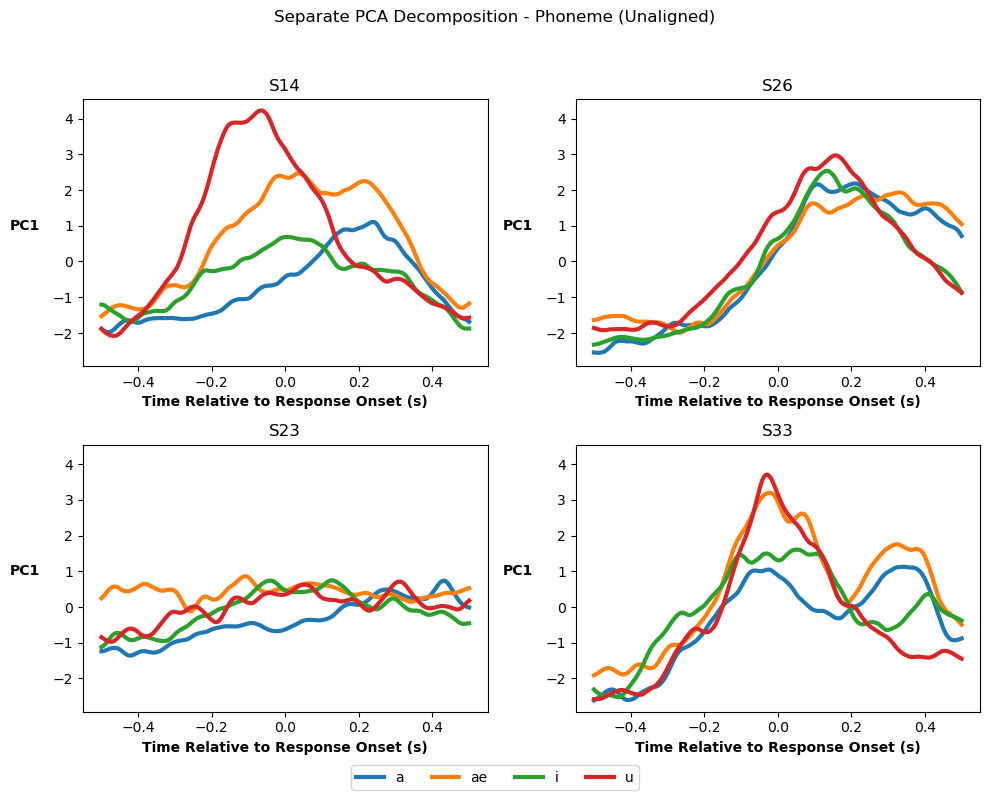

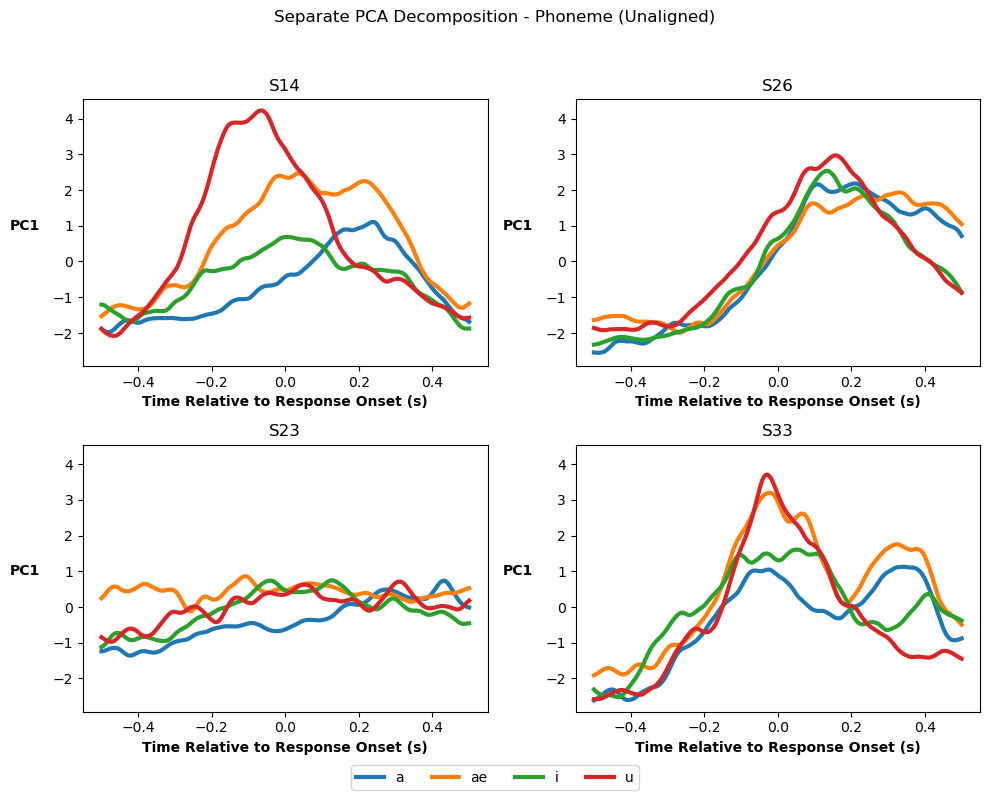

In [28]:
from alignment_visualization import plot_1D_lat_dyn

t = np.linspace(-0.5, 0.5, S14_hg_trace.shape[1])
plot_1D_lat_dyn(t, [S14_hg_pca, S26_hg_pca, S23_hg_pca, S33_hg_pca],
                   [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                  #  [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                #    artic_labels,
                   phon_labels, 
                   ['S14', 'S26', 'S23', 'S33'], pc_ind=0,
                #    title='Joint PCA Decomposition - Articulator (Unaligned)',
                   title='Separate PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True, figsize=(10, 8))

In [29]:
from utils import label2str

S14_phon_seqs = label2str(S14_phon_labels)
S26_phon_seqs = label2str(S26_phon_labels)
S23_phon_seqs = label2str(S23_phon_labels)
S33_phon_seqs = label2str(S33_phon_labels)

In [30]:
from alignment_methods import CCAAlign

cca1, cca2, cca3 = CCAAlign(), CCAAlign(), CCAAlign()
cca1.fit(S14_hg_pca, S26_hg_pca, S14_phon_seqs, S26_phon_seqs)
cca2.fit(S14_hg_pca, S23_hg_pca, S14_phon_seqs, S23_phon_seqs)
cca3.fit(S14_hg_pca, S33_hg_pca, S14_phon_seqs, S33_phon_seqs)

S26_pca_S14_algn = cca1.transform(S26_hg_pca)
S23_pca_S14_algn = cca2.transform(S23_hg_pca)
S33_pca_S14_algn = cca3.transform(S33_hg_pca)

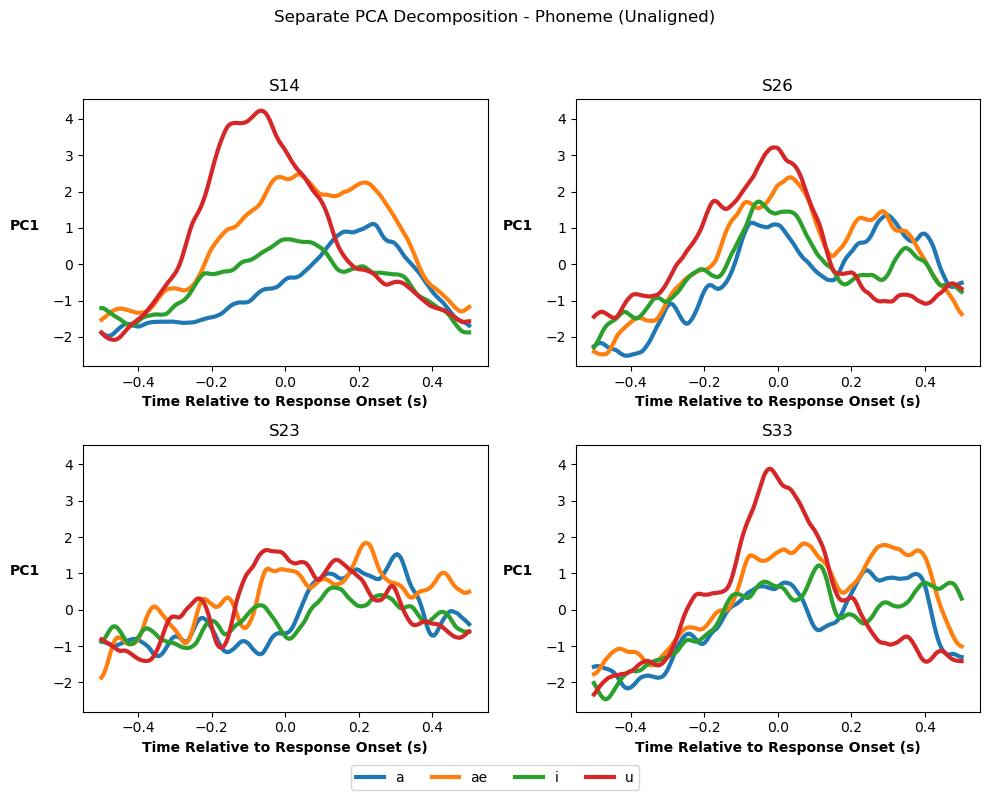

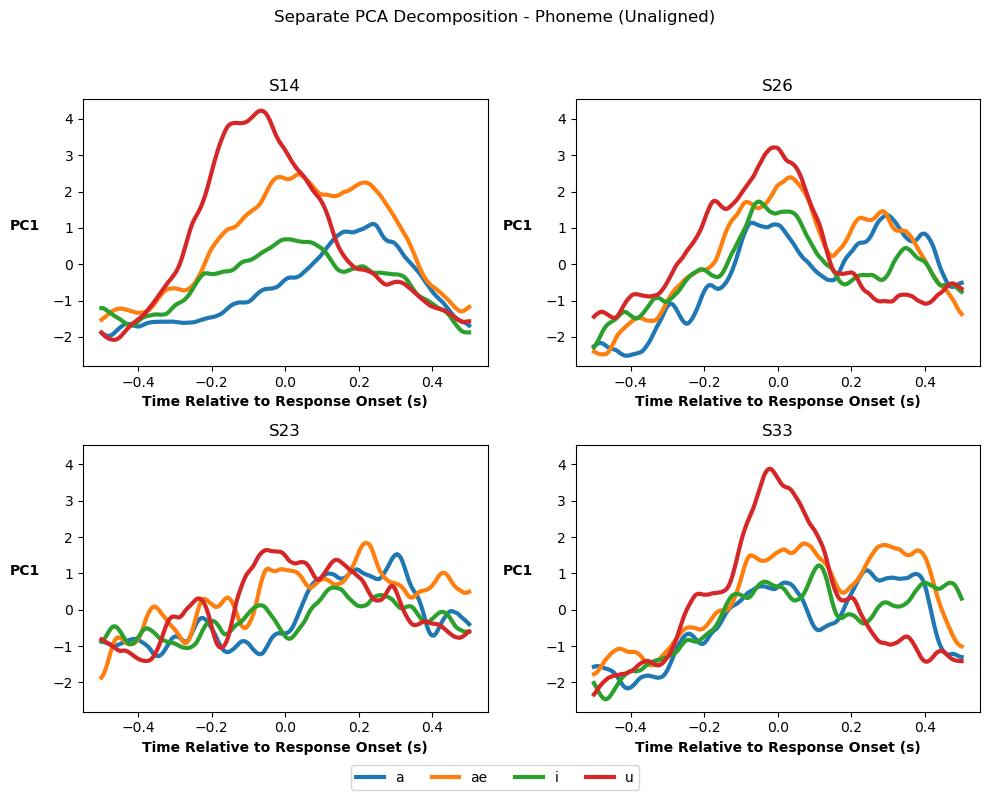

In [31]:
plot_1D_lat_dyn(t, [S14_hg_pca, S26_pca_S14_algn, S23_pca_S14_algn, S33_pca_S14_algn],
                   [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                #    [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                #    artic_labels,
                   phon_labels, 
                   ['S14', 'S26', 'S23', 'S33'], pc_ind=0,
                #    title='Joint PCA Decomposition - Articulator (Unaligned)',
                   title='Separate PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True, figsize=(10, 8))

Correlation Unaligned

In [32]:
from functools import reduce
from utils import cnd_avg
from metrics import pt_corr_multi

S14_pca_cnd_avg = cnd_avg(S14_hg_pca, S14_phon_seqs)
S26_pca_cnd_avg = cnd_avg(S26_hg_pca, S26_phon_seqs)
S23_pca_cnd_avg = cnd_avg(S23_hg_pca, S23_phon_seqs)
S33_pca_cnd_avg = cnd_avg(S33_hg_pca, S33_phon_seqs)

# only use same conditions across datasets
cnd_avg_data = [S14_pca_cnd_avg, S26_pca_cnd_avg, S23_pca_cnd_avg, S33_pca_cnd_avg]
labels = [S14_phon_seqs, S26_phon_seqs, S23_phon_seqs, S33_phon_seqs]
shared_lab = reduce(np.intersect1d, labels)
cnd_avg_data = [cnd_avg_data[i][np.isin(np.unique(lab), shared_lab,
                                        assume_unique=True)] for i, lab
                in enumerate(labels)]
# print([d.shape for d in cnd_avg_data])

unalgn_corr = pt_corr_multi(cnd_avg_data[0], cnd_avg_data[1:])

S26_pca_algn_cnd_avg = cnd_avg(S26_pca_S14_algn, S26_phon_seqs)
S23_pca_algn_cnd_avg = cnd_avg(S23_pca_S14_algn, S23_phon_seqs)
S33_pca_algn_cnd_avg = cnd_avg(S33_pca_S14_algn, S33_phon_seqs)

cnd_avg_data_algn = [S14_pca_cnd_avg, S26_pca_algn_cnd_avg, S23_pca_algn_cnd_avg, S33_pca_algn_cnd_avg]
shared_lab_algn = reduce(np.intersect1d, labels)
cnd_avg_data_algn = [cnd_avg_data_algn[i][np.isin(np.unique(lab), shared_lab,
                                          assume_unique=True)] for i, lab
                     in enumerate(labels)]
# print([d.shape for d in cnd_avg_data_algn])

algn_corr = pt_corr_multi(cnd_avg_data_algn[0], cnd_avg_data_algn[1:])

In [33]:
print([np.mean(corr) for corr in unalgn_corr])
print([np.mean(corr) for corr in algn_corr])

[0.20330893801587055, 0.005426702455591563, 0.1895903054250265]
[0.45039594133493704, 0.2520234338093799, 0.40338567569227934]


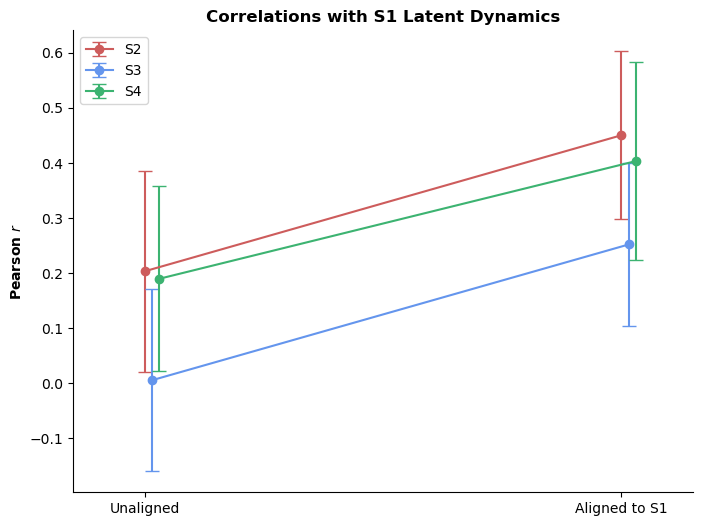

In [34]:
colors = ['indianred', 'cornflowerblue', 'mediumseagreen']
pts = ['S2', 'S3', 'S4']

plt.figure(figsize=(8,6))
for pt in range(len(unalgn_corr)):
    plt.errorbar((0+0.015*pt, 1+0.015*pt), (np.mean(unalgn_corr[pt]), np.mean(algn_corr[pt])), yerr=(np.std(unalgn_corr[pt]), np.std(algn_corr[pt])), color=colors[pt], fmt='-o', capsize=5, label=pts[pt])
plt.xticks((0, 1), ('Unaligned', 'Aligned to S1'))
plt.xlim([-0.15, 1.15])
plt.ylabel(r'Pearson $\it{r}$', weight='bold')
plt.title('Correlations with S1 Latent Dynamics', weight='bold')
plt.legend()
sns.despine()
plt.show()


# Joint PCA decomposition Exploration and Visualization

In [35]:
from sklearn.decomposition import PCA, KernelPCA
from sklearn.manifold import Isomap
from utils import cnd_avg, label2str

S14_artic_seqs = label2str(S14_artic_labels)
S14_phon_seqs = label2str(S14_phon_labels)
S14_phon_cnd_avg = np.swapaxes(cnd_avg(S14_hg_trace, S14_phon_seqs), 0, -1)
print(S14_phon_cnd_avg.shape)
S14_artic_cnd_avg = np.swapaxes(cnd_avg(S14_hg_trace, S14_artic_seqs), 0, -1)
print(S14_artic_cnd_avg.shape)

S26_artic_seqs = label2str(S26_artic_labels)
S26_phon_seqs = label2str(S26_phon_labels)
S26_phon_cnd_avg = np.swapaxes(cnd_avg(S26_hg_trace, S26_phon_seqs), 0, -1)
print(S26_phon_cnd_avg.shape)
S26_artic_cnd_avg = np.swapaxes(cnd_avg(S26_hg_trace, S26_artic_seqs), 0, -1)
print(S26_artic_cnd_avg.shape)

S23_artic_seqs = label2str(S23_artic_labels)
S23_phon_seqs = label2str(S23_phon_labels)
S23_phon_cnd_avg = np.swapaxes(cnd_avg(S23_hg_trace, S23_phon_seqs), 0, -1)
print(S23_phon_cnd_avg.shape)
S23_artic_cnd_avg = np.swapaxes(cnd_avg(S23_hg_trace, S23_artic_seqs), 0, -1)
print(S23_artic_cnd_avg.shape)

S33_artic_seqs = label2str(S33_artic_labels)
S33_phon_seqs = label2str(S33_phon_labels)
S33_phon_cnd_avg = np.swapaxes(cnd_avg(S33_hg_trace, S33_phon_seqs), 0, -1)
print(S33_phon_cnd_avg.shape)
S33_artic_cnd_avg = np.swapaxes(cnd_avg(S33_hg_trace, S33_artic_seqs), 0, -1)
print(S33_artic_cnd_avg.shape)
print()

cross_pt_phon_mat = np.concatenate([S14_phon_cnd_avg, S26_phon_cnd_avg, S23_phon_cnd_avg], axis=0)
cross_pt_artic_mat = np.concatenate([S14_artic_cnd_avg, S26_artic_cnd_avg, S23_artic_cnd_avg, S33_artic_cnd_avg], axis=0)
print(cross_pt_phon_mat.shape)
print(cross_pt_artic_mat.shape)

dr = PCA(n_components=0.8)
# dr = KernelPCA(n_components=40, kernel='rbf')
# dr = Isomap(n_components=40)
phon_factor_mat = dr.fit_transform(cross_pt_phon_mat.reshape(cross_pt_phon_mat.shape[0], -1).T).T
artic_factor_mat = dr.fit_transform(cross_pt_artic_mat.reshape(cross_pt_artic_mat.shape[0], -1).T).T
print(phon_factor_mat.shape)
print(artic_factor_mat.shape)

(111, 200, 52)
(111, 200, 15)
(111, 200, 52)
(111, 200, 15)
(63, 200, 52)
(63, 200, 15)
(149, 200, 46)
(149, 200, 15)

(285, 200, 52)
(434, 200, 15)
(27, 10400)
(23, 3000)


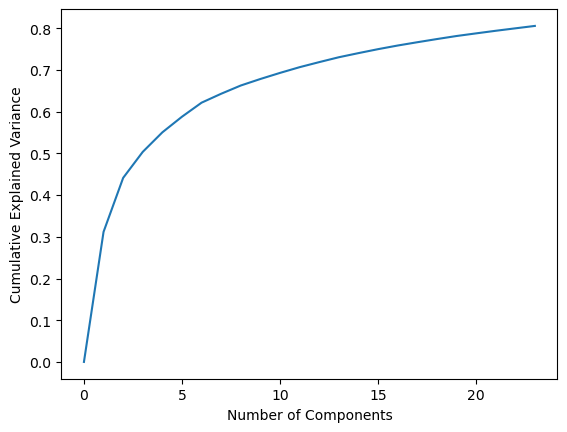

In [36]:
import matplotlib.pyplot as plt

plt.figure()
plt.plot([0] + [*np.cumsum(dr.explained_variance_ratio_)])
plt.ylabel('Cumulative Explained Variance')
plt.xlabel('Number of Components')
plt.show()

# print(np.cumsum(dr.explained_variance_ratio_))

# expl_thresh = 0.9
# comp_expl = np.where(np.cumsum(pca.explained_variance_ratio_) > expl_thresh)[0][0]
# print(f'Number of components to explain {expl_thresh*100}% of variance: {comp_expl}')

Phoneme Condition Averaging

In [37]:
##### wrong but useful for patient-specific #####

# S14_factor_trans = np.linalg.pinv(phon_factor_mat).T @ S14_phon_cnd_avg.reshape(S14_phon_cnd_avg.shape[0], -1).T
# print(S14_factor_trans.shape)
# S14_joint_decomp = S14_hg_trace.reshape(-1, S14_hg_trace.shape[-1]) @ S14_factor_trans.T
# S14_joint_decomp = S14_joint_decomp.reshape(S14_hg_trace.shape[0], S14_hg_trace.shape[1], -1)
# print(S14_joint_decomp.shape)
# print()

# S26_factor_trans = np.linalg.pinv(phon_factor_mat).T @ S26_phon_cnd_avg.reshape(S26_phon_cnd_avg.shape[0], -1).T
# print(S26_factor_trans.shape)
# S26_joint_decomp = S26_hg_trace.reshape(-1, S26_hg_trace.shape[-1]) @ S26_factor_trans.T
# S26_joint_decomp = S26_joint_decomp.reshape(S26_hg_trace.shape[0], S26_hg_trace.shape[1], -1)
# print(S26_joint_decomp.shape)
# print()

# S23_factor_trans = np.linalg.pinv(phon_factor_mat).T @ S23_phon_cnd_avg.reshape(S23_phon_cnd_avg.shape[0], -1).T
# print(S23_factor_trans.shape)
# S23_joint_decomp = S23_hg_trace.reshape(-1, S23_hg_trace.shape[-1]) @ S23_factor_trans.T
# S23_joint_decomp = S23_joint_decomp.reshape(S23_hg_trace.shape[0], S23_hg_trace.shape[1], -1)
# print(S23_joint_decomp.shape)
# print()


##### correct joint PCA #####

S14_factor_trans = np.linalg.pinv(S14_phon_cnd_avg.reshape(S14_phon_cnd_avg.shape[0], -1).T)  @ phon_factor_mat.T
print(S14_factor_trans.shape)
S14_joint_decomp = S14_hg_trace.reshape(-1, S14_hg_trace.shape[-1]) @ S14_factor_trans
S14_joint_decomp = S14_joint_decomp.reshape(S14_hg_trace.shape[0], S14_hg_trace.shape[1], -1)
print(S14_joint_decomp.shape)
print()

# S26_factor_trans = np.linalg.pinv(phon_factor_mat).T @ S26_phon_cnd_avg.reshape(S26_phon_cnd_avg.shape[0], -1).T
S26_factor_trans = np.linalg.pinv(S26_phon_cnd_avg.reshape(S26_phon_cnd_avg.shape[0], -1).T)  @ phon_factor_mat.T
print(S26_factor_trans.shape)
S26_joint_decomp = S26_hg_trace.reshape(-1, S26_hg_trace.shape[-1]) @ S26_factor_trans
S26_joint_decomp = S26_joint_decomp.reshape(S26_hg_trace.shape[0], S26_hg_trace.shape[1], -1)
print(S26_joint_decomp.shape)
print()

# S23_factor_trans = np.linalg.pinv(phon_factor_mat).T @ S23_phon_cnd_avg.reshape(S23_phon_cnd_avg.shape[0], -1).T
S23_factor_trans = np.linalg.pinv(S23_phon_cnd_avg.reshape(S23_phon_cnd_avg.shape[0], -1).T)  @ phon_factor_mat.T
print(S23_factor_trans.shape)
S23_joint_decomp = S23_hg_trace.reshape(-1, S23_hg_trace.shape[-1]) @ S23_factor_trans
S23_joint_decomp = S23_joint_decomp.reshape(S23_hg_trace.shape[0], S23_hg_trace.shape[1], -1)
print(S23_joint_decomp.shape)
print()

(111, 27)
(144, 200, 27)

(111, 27)
(148, 200, 27)

(63, 27)
(151, 200, 27)



Articulator Condition Averaging

In [38]:
##### wrong but useful for patient-specific #####

S14_factor_trans = np.linalg.pinv(artic_factor_mat).T @ S14_artic_cnd_avg.reshape(S14_artic_cnd_avg.shape[0], -1).T
print(S14_factor_trans.shape)
S14_joint_decomp = S14_hg_trace.reshape(-1, S14_hg_trace.shape[-1]) @ S14_factor_trans.T
S14_joint_decomp = S14_joint_decomp.reshape(S14_hg_trace.shape[0], S14_hg_trace.shape[1], -1)
print(S14_joint_decomp.shape)
print()

S26_factor_trans = np.linalg.pinv(artic_factor_mat).T @ S26_artic_cnd_avg.reshape(S26_artic_cnd_avg.shape[0], -1).T
print(S26_factor_trans.shape)
S26_joint_decomp = S26_hg_trace.reshape(-1, S26_hg_trace.shape[-1]) @ S26_factor_trans.T
S26_joint_decomp = S26_joint_decomp.reshape(S26_hg_trace.shape[0], S26_hg_trace.shape[1], -1)
print(S26_joint_decomp.shape)
print()

S23_factor_trans = np.linalg.pinv(artic_factor_mat).T @ S23_artic_cnd_avg.reshape(S23_artic_cnd_avg.shape[0], -1).T
print(S23_factor_trans.shape)
S23_joint_decomp = S23_hg_trace.reshape(-1, S23_hg_trace.shape[-1]) @ S23_factor_trans.T
S23_joint_decomp = S23_joint_decomp.reshape(S23_hg_trace.shape[0], S23_hg_trace.shape[1], -1)
print(S23_joint_decomp.shape)
print()

S33_factor_trans = np.linalg.pinv(artic_factor_mat).T @ S33_artic_cnd_avg.reshape(S33_artic_cnd_avg.shape[0], -1).T
print(S33_factor_trans.shape)
S33_joint_decomp = S33_hg_trace.reshape(-1, S33_hg_trace.shape[-1]) @ S33_factor_trans.T
S33_joint_decomp = S33_joint_decomp.reshape(S33_hg_trace.shape[0], S33_hg_trace.shape[1], -1)
print(S33_joint_decomp.shape)
print()


##### correct joint PCA #####

# S14_factor_trans = np.linalg.pinv(S14_artic_cnd_avg.reshape(S14_artic_cnd_avg.shape[0], -1).T)  @ artic_factor_mat.T
# print(S14_factor_trans.shape)
# S14_joint_decomp = S14_hg_trace.reshape(-1, S14_hg_trace.shape[-1]) @ S14_factor_trans
# S14_joint_decomp = S14_joint_decomp.reshape(S14_hg_trace.shape[0], S14_hg_trace.shape[1], -1)
# print(S14_joint_decomp.shape)
# print()

# S26_factor_trans = np.linalg.pinv(S26_artic_cnd_avg.reshape(S26_artic_cnd_avg.shape[0], -1).T)  @ artic_factor_mat.T
# print(S26_factor_trans.shape)
# S26_joint_decomp = S26_hg_trace.reshape(-1, S26_hg_trace.shape[-1]) @ S26_factor_trans
# S26_joint_decomp = S26_joint_decomp.reshape(S26_hg_trace.shape[0], S26_hg_trace.shape[1], -1)
# print(S26_joint_decomp.shape)
# print()

# S23_factor_trans = np.linalg.pinv(S23_artic_cnd_avg.reshape(S23_artic_cnd_avg.shape[0], -1).T)  @ artic_factor_mat.T
# print(S23_factor_trans.shape)
# S23_joint_decomp = S23_hg_trace.reshape(-1, S23_hg_trace.shape[-1]) @ S23_factor_trans
# S23_joint_decomp = S23_joint_decomp.reshape(S23_hg_trace.shape[0], S23_hg_trace.shape[1], -1)
# print(S23_joint_decomp.shape)
# print()

# S33_factor_trans = np.linalg.pinv(S33_artic_cnd_avg.reshape(S33_artic_cnd_avg.shape[0], -1).T)  @ artic_factor_mat.T
# print(S33_factor_trans.shape)
# S33_joint_decomp = S33_hg_trace.reshape(-1, S33_hg_trace.shape[-1]) @ S33_factor_trans
# S33_joint_decomp = S33_joint_decomp.reshape(S33_hg_trace.shape[0], S33_hg_trace.shape[1], -1)
# print(S33_joint_decomp.shape)
# print()

(23, 111)
(144, 200, 23)

(23, 111)
(148, 200, 23)

(23, 63)
(151, 200, 23)

(23, 149)
(46, 200, 23)



## Trace Visualization (Matplotlib)

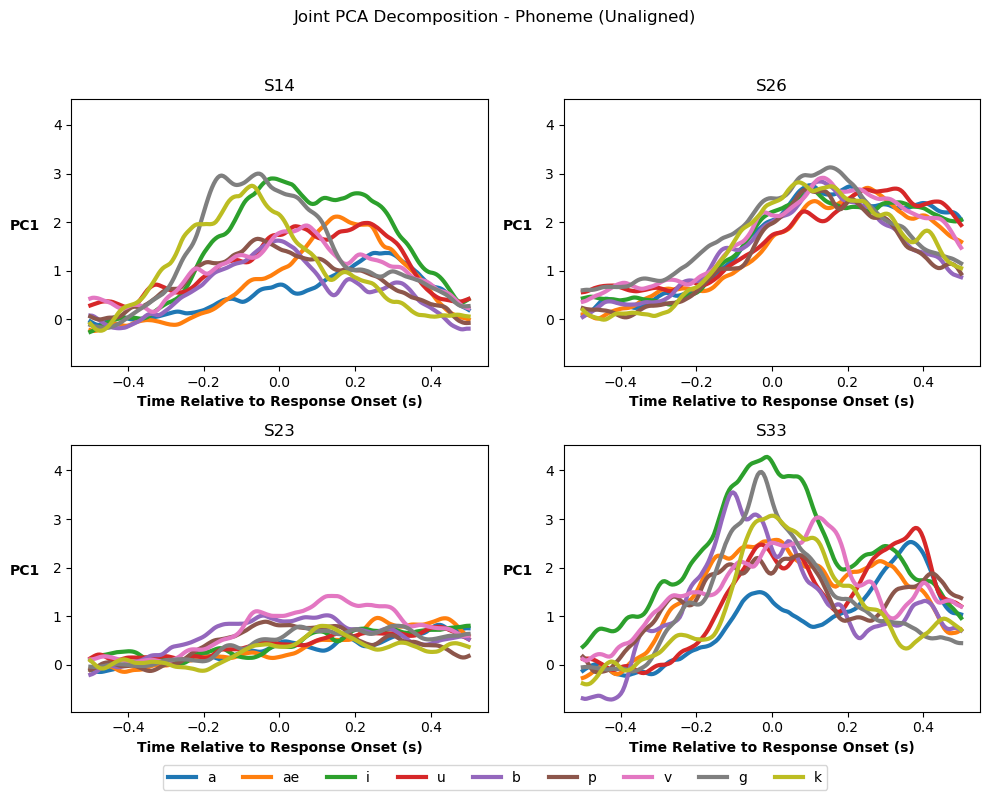

In [39]:
from alignment_visualization import plot_1D_lat_dyn, plot_2D_lat_dyn, plot_3D_lat_dyn

t = np.linspace(-0.5, 0.5, S14_hg_trace.shape[1])
_ = plot_1D_lat_dyn(t, [S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp],
                #    [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                   [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                #    artic_labels,
                   phon_labels, 
                   ['S14', 'S26', 'S23', 'S33'], pc_ind=0,
                #    title='Joint PCA Decomposition - Articulator (Unaligned)',
                   title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True, figsize=(10, 8))

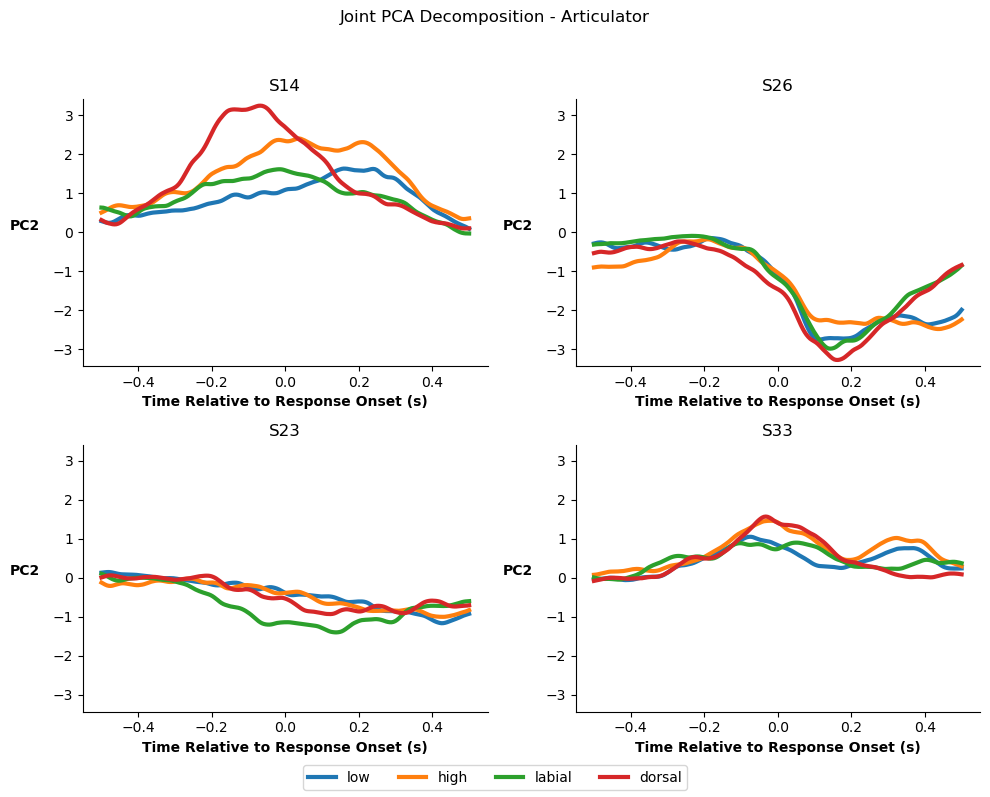

In [40]:
t = np.linspace(-0.5, 0.5, S14_hg_trace.shape[1])
f = plot_1D_lat_dyn(t, [S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp],
                   [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                #    [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                   artic_labels,
                #    phon_labels, 
                   ['S14', 'S26', 'S23', 'S33'], pc_ind=1,
                   title='Joint PCA Decomposition - Articulator',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True, figsize=(10, 8))
sns.despine(f)
plt.show()

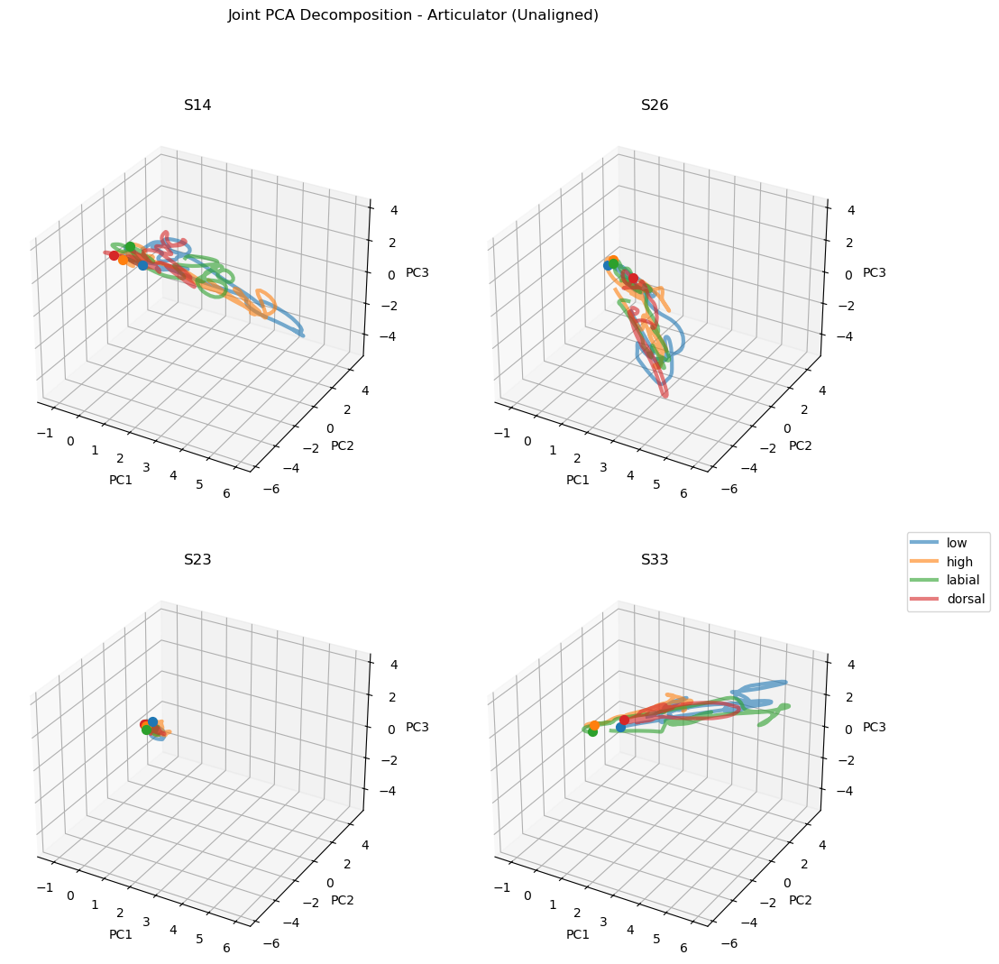

In [41]:
f = plot_3D_lat_dyn([S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp],
                   [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                  #  [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                   artic_labels,
                  #  phon_labels, 
                   ['S14', 'S26', 'S23', 'S33'],
                   title='Joint PCA Decomposition - Articulator (Unaligned)',
                  #  title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True)

In [42]:
S14_cv_seqs = np.ones(S14_str_labels_cv_seq.shape)
S14_cv_seqs[np.where(S14_str_labels_cv_seq == 'vcv')] = 2

S26_cv_seqs = np.ones(S26_str_labels_cv_seq.shape)
S26_cv_seqs[np.where(S26_str_labels_cv_seq == 'vcv')] = 2

S23_cv_seqs = np.ones(S23_str_labels_cv_seq.shape)
S23_cv_seqs[np.where(S23_str_labels_cv_seq == 'vcv')] = 2

S33_cv_seqs = np.ones(S33_str_labels_cv_seq.shape)
S33_cv_seqs[np.where(S33_str_labels_cv_seq == 'vcv')] = 2

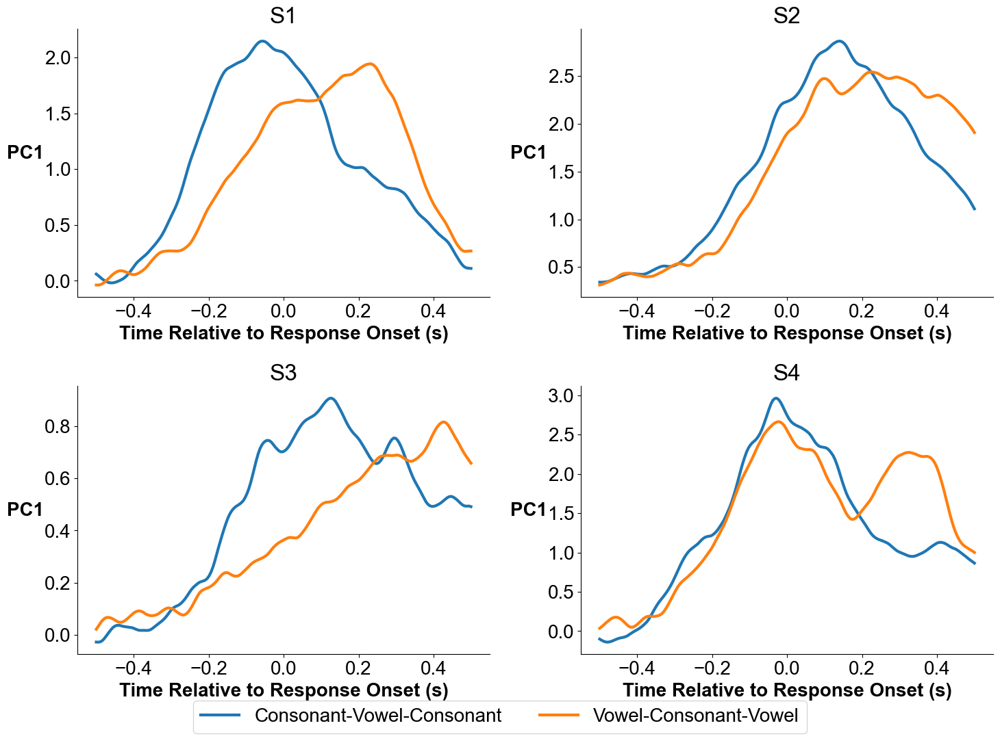

In [43]:
import matplotlib

font = {'family' : 'sans-serif',
        'sans-serif' : 'Arial',
        'weight' : 'normal',
        'size'   : 20}
matplotlib.rc('font', **font)

t = np.linspace(-0.5, 0.5, S14_hg_trace.shape[1])
f = plot_1D_lat_dyn(t, [S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp],
                   [S14_cv_seqs, S26_cv_seqs, S23_cv_seqs, S33_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S1', 'S2', 'S3', 'S4'], pc_ind=0,
                   title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=False,
                   figsize=(15,12))
sns.despine(f)
plt.show()

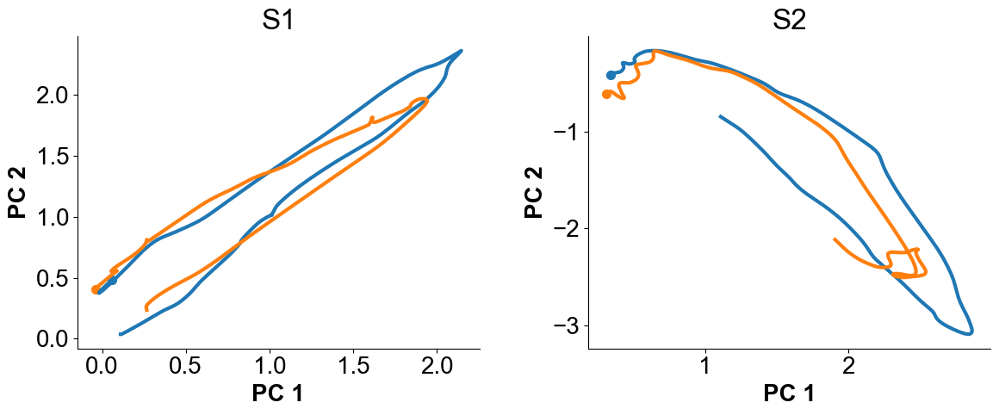

In [44]:
f = plot_2D_lat_dyn([S14_joint_decomp, S26_joint_decomp],
                   [S14_cv_seqs, S26_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S1', 'S2'], title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=False,
                   figsize=(12,6))
sns.despine(f)
plt.show()

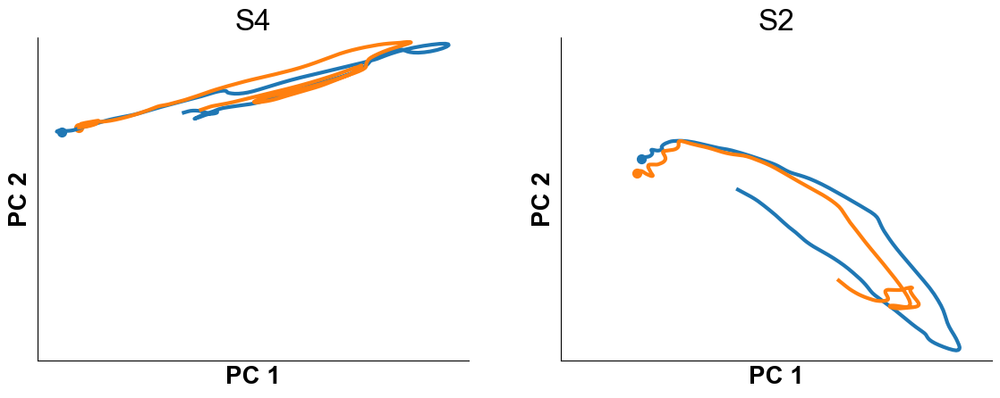

In [45]:
f = plot_2D_lat_dyn([S33_joint_decomp, S26_joint_decomp],
                   [S33_cv_seqs, S26_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S4', 'S2'], title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True,
                   figsize=(12,6))
for ax in f.axes:
   ax.xaxis.set_ticks([])
   ax.yaxis.set_ticks([])
sns.despine(f)
plt.show()

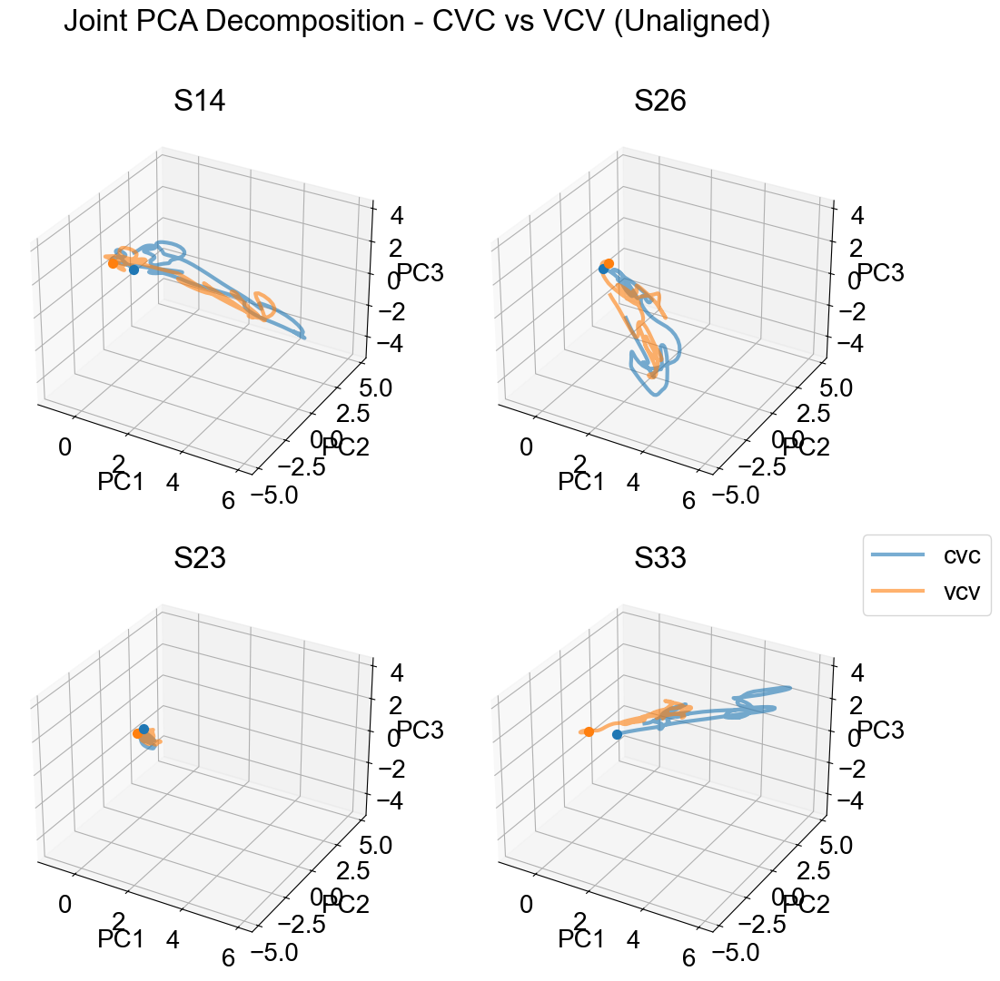

In [46]:
_ = plot_3D_lat_dyn([S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp],
                   [S14_cv_seqs, S26_cv_seqs, S23_cv_seqs, S33_cv_seqs],
                   ['cvc', 'vcv'],
                   ['S14', 'S26', 'S23', 'S33'],
                   title='Joint PCA Decomposition - CVC vs VCV (Unaligned)',
                   same_axes=True)

Aligning Joint Decomposition

In [47]:
from alignment_methods import CCA_align_by_class

In [48]:
_, X_S26_S14 = CCA_align_by_class(S14_joint_decomp, S26_joint_decomp, S14_artic_labels, S26_artic_labels, return_space='b_to_a')
_, X_S23_S14 = CCA_align_by_class(S14_joint_decomp, S23_joint_decomp, S14_artic_labels, S23_artic_labels, return_space='b_to_a')
_, X_S33_S14 = CCA_align_by_class(S14_joint_decomp, S33_joint_decomp, S14_artic_labels, S33_artic_labels, return_space='b_to_a')

_, X_S14_S33 = CCA_align_by_class(S33_joint_decomp, S14_joint_decomp, S33_artic_labels, S14_artic_labels, return_space='b_to_a')
_, X_S26_S33 = CCA_align_by_class(S33_joint_decomp, S26_joint_decomp, S33_artic_labels, S26_artic_labels, return_space='b_to_a')
_, X_S23_S33 = CCA_align_by_class(S33_joint_decomp, S23_joint_decomp, S33_artic_labels, S23_artic_labels, return_space='b_to_a')

# _, X_S26_S14 = CCA_align_by_class(S14_joint_decomp, S26_joint_decomp, S14_phon_labels, S26_phon_labels, return_space='b_to_a')
# _, X_S23_S14 = CCA_align_by_class(S14_joint_decomp, S23_joint_decomp, S14_phon_labels, S23_phon_labels, return_space='b_to_a')
# _, X_S33_S14 = CCA_align_by_class(S14_joint_decomp, S33_joint_decomp, S14_phon_labels, S33_phon_labels, return_space='b_to_a')

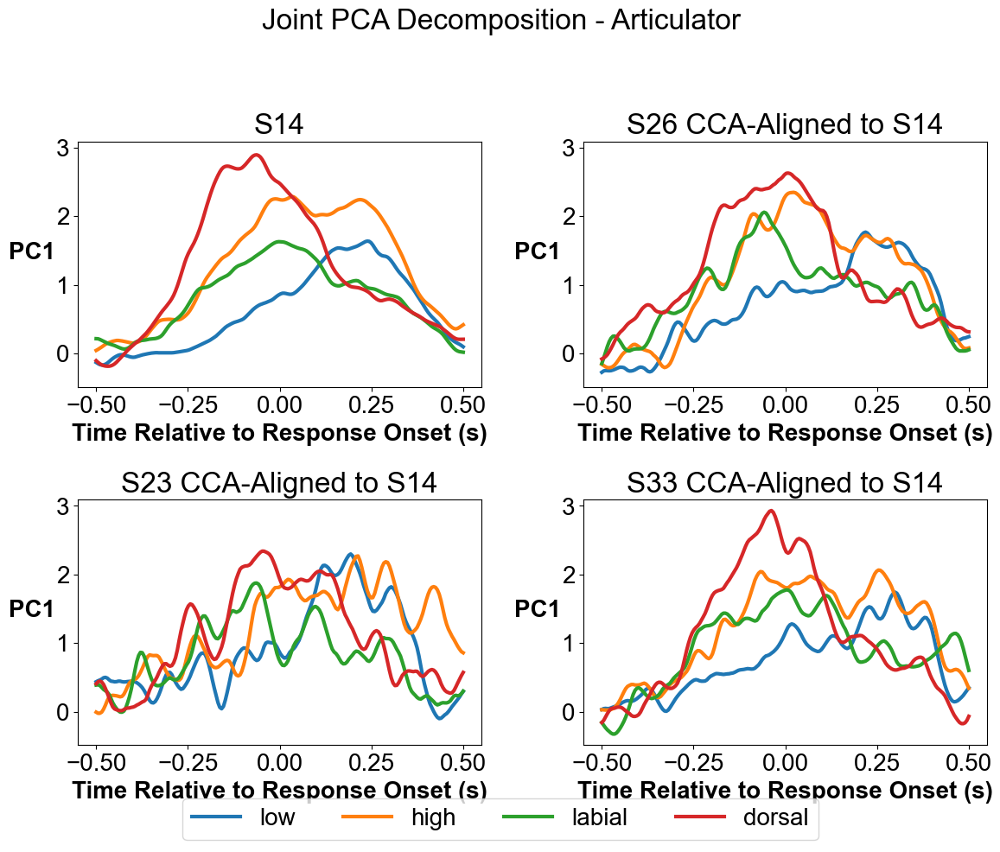

In [49]:
_ = plot_1D_lat_dyn(t, [S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                   [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                #    [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                   artic_labels,
                #    phon_labels, 
                   ['S14', 'S26 CCA-Aligned to S14', 'S23 CCA-Aligned to S14', 'S33 CCA-Aligned to S14'], pc_ind=0,
                   title='Joint PCA Decomposition - Articulator',
                #    title='Joint PCA Decomposition - Phoneme',
                   same_axes=True)

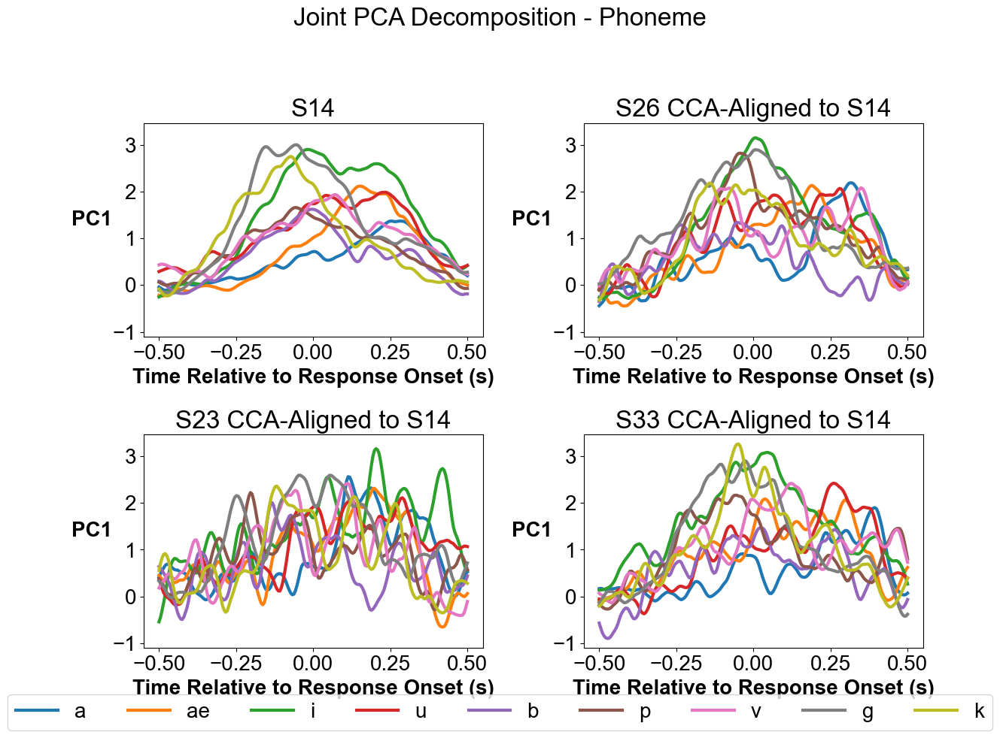

In [50]:
_ = plot_1D_lat_dyn(t, [S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                #    [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                   [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                #    artic_labels,
                   phon_labels, 
                   ['S14', 'S26 CCA-Aligned to S14', 'S23 CCA-Aligned to S14', 'S33 CCA-Aligned to S14'], pc_ind=0,
                #    title='Joint PCA Decomposition - Articulator',
                   title='Joint PCA Decomposition - Phoneme',
                   same_axes=True)

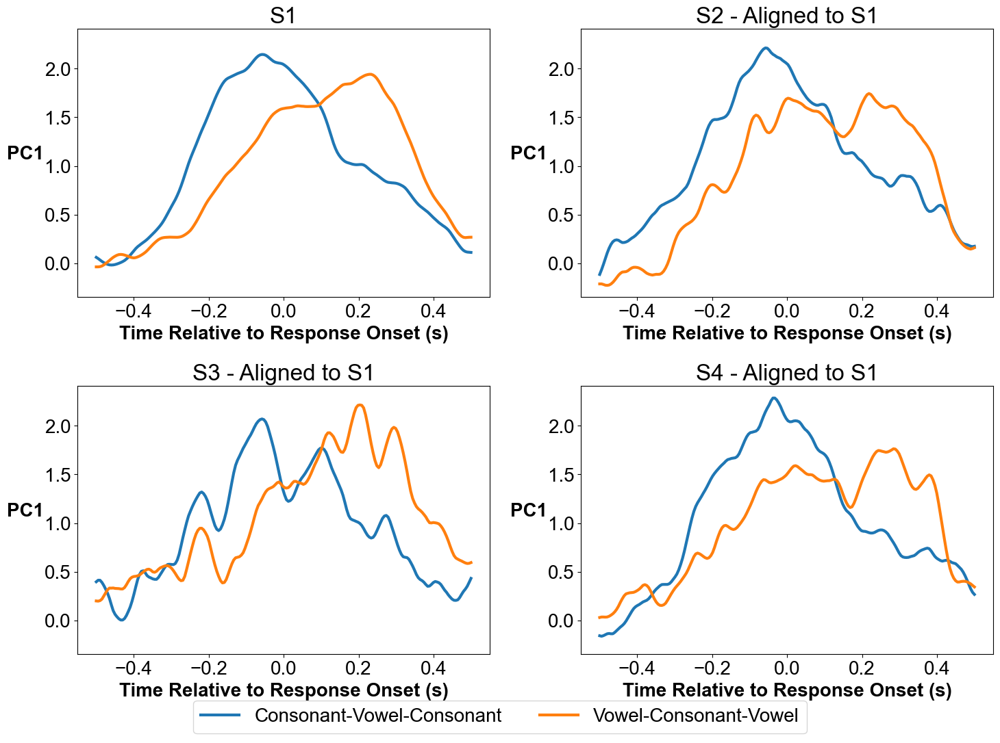

In [51]:
_ = plot_1D_lat_dyn(t, [S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                   [S14_cv_seqs, S26_cv_seqs, S23_cv_seqs, S33_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S1', 'S2 - Aligned to S1', 'S3 - Aligned to S1', 'S4 - Aligned to S1'], pc_ind=0,
                   title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True, figsize=(15,12))

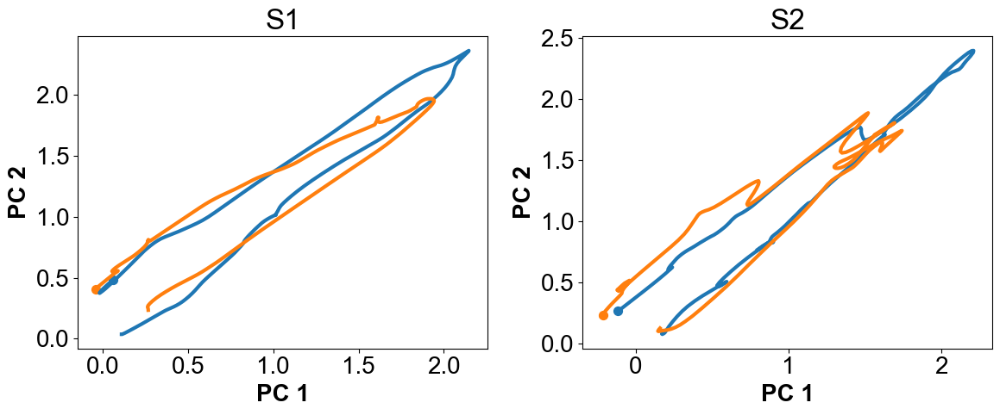

In [52]:
_ = plot_2D_lat_dyn([S14_joint_decomp, X_S26_S14],
                   [S14_cv_seqs, S26_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S1', 'S2'], title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=False,
                   figsize=(12,6))

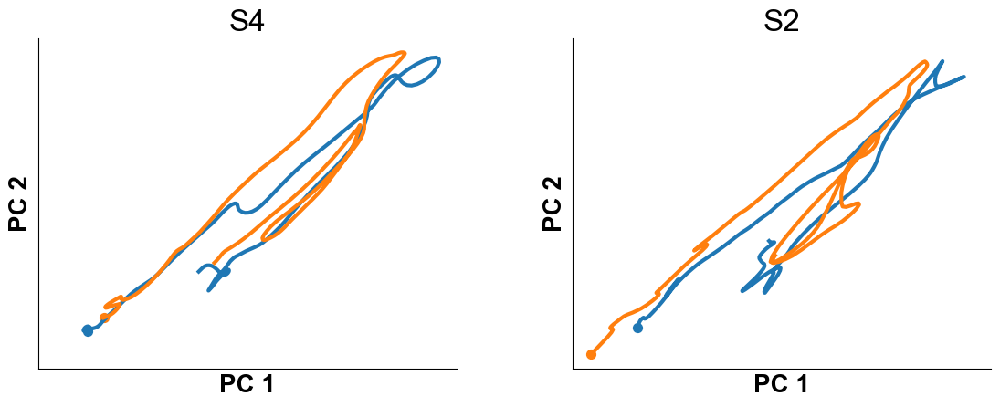

In [53]:
f = plot_2D_lat_dyn([S33_joint_decomp, X_S26_S33],
                   [S33_cv_seqs, S26_cv_seqs],
                   ['Consonant-Vowel-Consonant', 'Vowel-Consonant-Vowel'],
                   ['S4', 'S2'], title='',
                #    title='Joint PCA Decomposition - Phoneme (Unaligned)',
                   same_axes=True,
                   figsize=(12,6))
for ax in f.axes:
   ax.xaxis.set_ticks([])
   ax.yaxis.set_ticks([])
sns.despine(f)
plt.show()

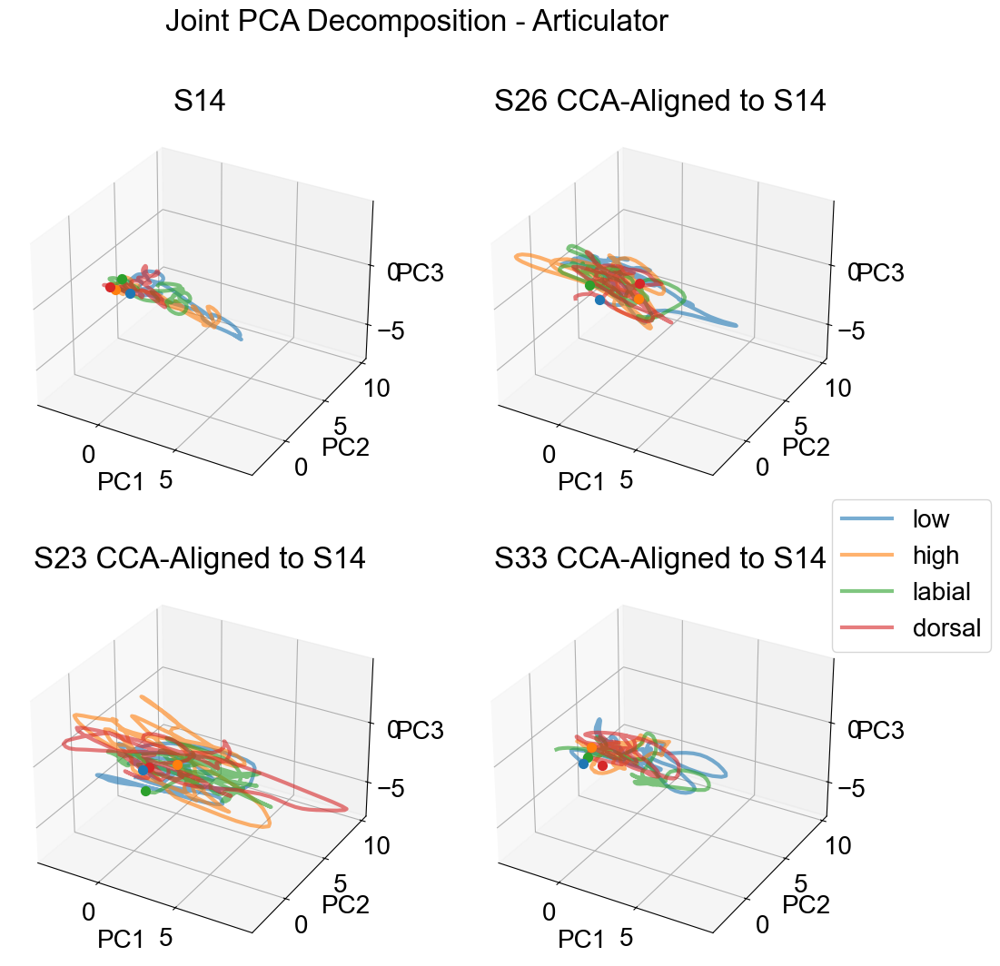

In [54]:
_ = plot_3D_lat_dyn([S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                # [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                artic_labels,
                # phon_labels,
                ['S14', 'S26 CCA-Aligned to S14', 'S23 CCA-Aligned to S14', 'S33 CCA-Aligned to S14'],
                title='Joint PCA Decomposition - Articulator',
                # title='Joint PCA Decomposition - Phoneme',
                same_axes=True)

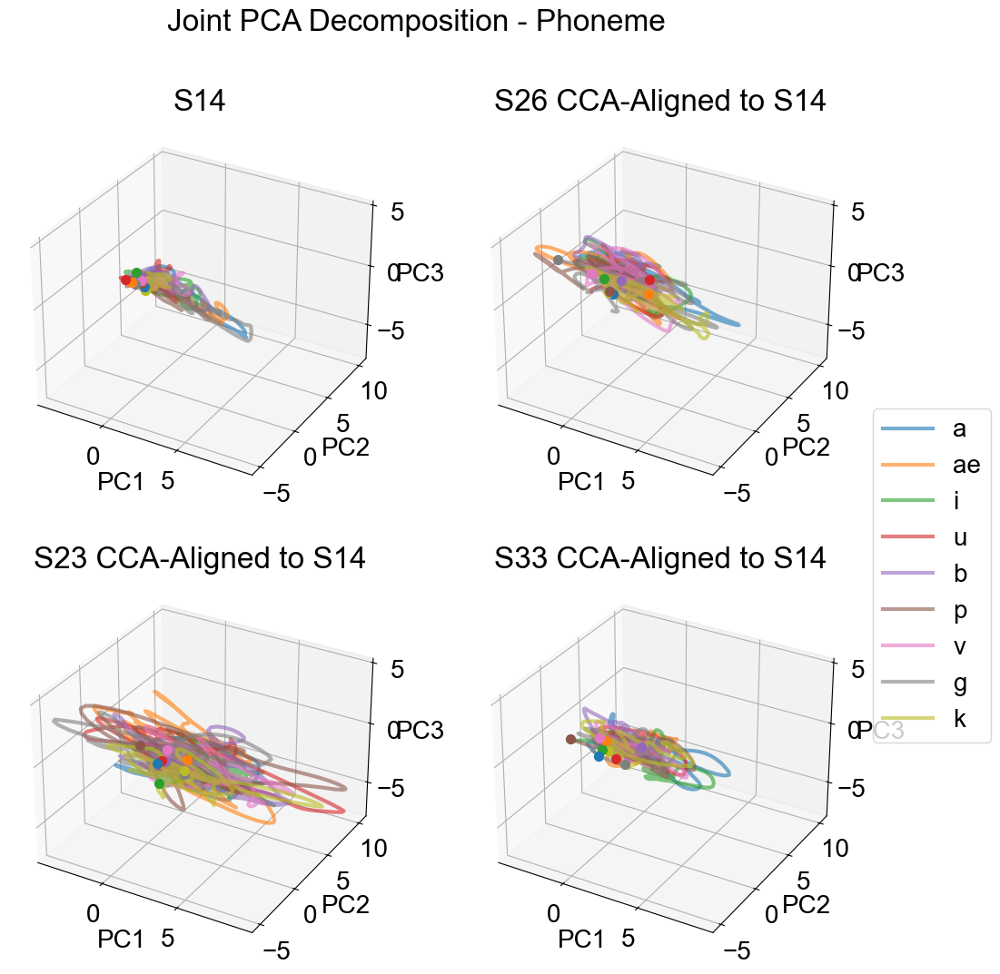

In [55]:
_ = plot_3D_lat_dyn([S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                # [S14_artic_labels[:,0], S26_artic_labels[:,0], S23_artic_labels[:,0], S33_artic_labels[:,0]],
                [S14_phon_labels[:,0], S26_phon_labels[:,0], S23_phon_labels[:,0], S33_phon_labels[:,0]],
                # artic_labels,
                phon_labels,
                ['S14', 'S26 CCA-Aligned to S14', 'S23 CCA-Aligned to S14', 'S33 CCA-Aligned to S14'],
                # title='Joint PCA Decomposition - Articulator',
                title='Joint PCA Decomposition - Phoneme',
                same_axes=True)

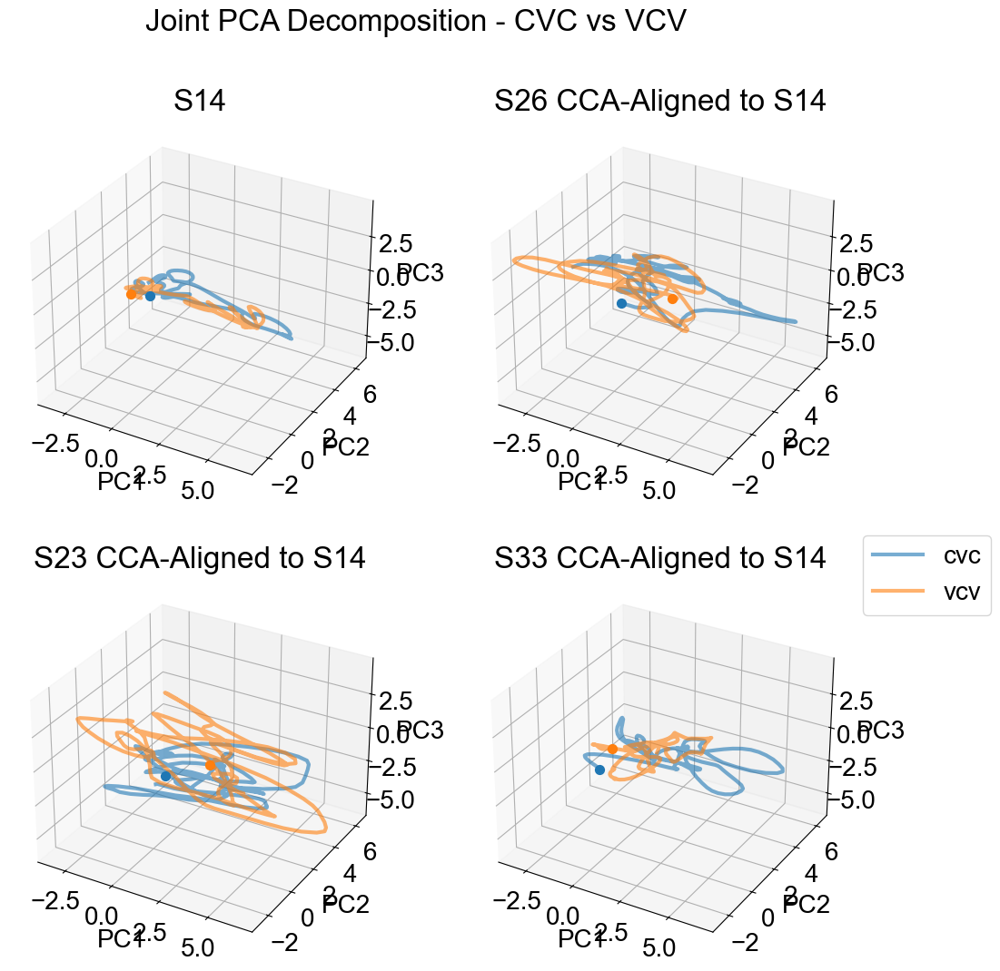

In [56]:
_ = plot_3D_lat_dyn([S14_joint_decomp, X_S26_S14, X_S23_S14, X_S33_S14],
                   [S14_cv_seqs, S26_cv_seqs, S23_cv_seqs, S33_cv_seqs],
                   ['cvc', 'vcv'],
                   ['S14', 'S26 CCA-Aligned to S14', 'S23 CCA-Aligned to S14', 'S33 CCA-Aligned to S14'],
                   title='Joint PCA Decomposition - CVC vs VCV',
                   same_axes=True)

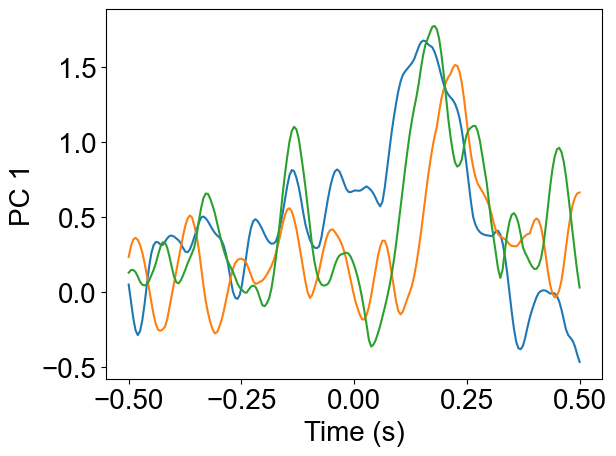

In [57]:
tr_ind = 0

plt.figure()
plt.plot(t, S14_joint_decomp[np.where(S14_phon_seqs == np.unique(S14_phon_seqs)[tr_ind])[0],:,0].T)
plt.ylabel('PC 1')
plt.xlabel('Time (s)')
plt.show()

## Pandas + Plotly Visualization

In [58]:
import pandas as pd
import plotly.express as px

In [59]:
S14_full_labels = np.array([''.join([phon_labels[i-1] for i in seq]) for seq in S14_phon_labels])
S26_full_labels = np.array([''.join([phon_labels[i-1] for i in seq]) for seq in S26_phon_labels])
S23_full_labels = np.array([''.join([phon_labels[i-1] for i in seq]) for seq in S23_phon_labels])
S33_full_labels = np.array([''.join([phon_labels[i-1] for i in seq]) for seq in S33_phon_labels])

In [69]:
t = np.linspace(-0.5, 0.5 - 1/S14_hg_trace.shape[1], S14_hg_trace.shape[1])
pt_names = ['S1', 'S2', 'S3', 'S4']
pt_labels = [S14_full_labels, S26_full_labels, S23_full_labels, S33_full_labels]
data_unalgn = [S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp]

wide_dfs = []
long_dfs = []
for i, pt in enumerate(pt_names):
    d = data_unalgn[i]
    d = d.reshape(-1, d.shape[-1])
    df = pd.DataFrame(d, columns=[f'PC {i+1}' for i in range(d.shape[-1])])
    df['Time'] = np.tile(t, data_unalgn[i].shape[0])
    df['Patient'] = [pt] * d.shape[0]
    df['Trial'] = np.repeat(pt_labels[i], t.shape[0])
    cols = df.columns.tolist()
    cols = cols[-3:] + cols[:-3]
    df = df[cols]
    wide_dfs.append(df)
    df = df.melt(id_vars=['Time', 'Patient', 'Trial'], var_name='PC', value_name='Value')
    df['PC'] = df['PC'].apply(lambda x: int(x.split(' ')[-1]))
    df['PC'] = df['PC'] + 1
    df = df[['Patient', 'Trial', 'Time', 'PC', 'Value']]
    long_dfs.append(df)
unalgn_wide_df = pd.concat(wide_dfs)
unalgn_long_df = pd.concat(long_dfs)


In [70]:
unalgn_wide_df


,Time,Patient,Trial,PC 1,PC 2,PC 3,PC 4,PC 5,PC 6,PC 7,...,PC 14,PC 15,PC 16,PC 17,PC 18,PC 19,PC 20,PC 21,PC 22,PC 23
0,-0.500,S1,kab,-0.201943,0.095188,0.290830,0.270290,0.126030,0.387399,0.096517,...,0.021521,-0.155933,-0.094514,-0.004396,-0.054543,-0.036945,0.280338,-0.236403,-0.101297,0.620075
1,-0.495,S1,kab,-0.277996,0.026179,0.407236,0.293979,0.201331,0.379472,0.109571,...,-0.009563,-0.120212,-0.132668,0.009650,-0.015665,-0.044775,0.309290,-0.191845,-0.147172,0.598738
2,-0.490,S1,kab,-0.362174,-0.038427,0.540649,0.326893,0.285935,0.385795,0.137967,...,-0.031802,-0.080181,-0.160588,0.042083,0.040812,-0.053973,0.341646,-0.150106,-0.199464,0.568701
3,-0.485,S1,kab,-0.443162,-0.092415,0.680143,0.366375,0.365249,0.406794,0.178005,...,-0.047634,-0.046373,-0.171210,0.086996,0.102016,-0.061077,0.369563,-0.119577,-0.246919,0.536252
4,-0.480,S1,kab,-0.508486,-0.133597,0.809548,0.405561,0.428030,0.432595,0.229829,...,-0.063648,-0.024618,-0.164707,0.149353,0.171128,-0.069034,0.385073,-0.094821,-0.297145,0.499725
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9195,0.475,S4,gub,1.594263,0.522673,1.308137,-0.576098,0.665762,-0.724318,0.958845,...,0.391855,-0.065229,0.211157,0.363239,0.186446,0.167594,-0.200724,-0.418913,-0.254216,0.143862
9196,0.480,S4,gub,1.598601,0.543807,1.308401,-0.582223,0.670841,-0.704603,0.954993,...,0.398705,0.086349,0.217106,0.288069,0.269372,0.160496,-0.186251,-0.408142,-0.217379,0.130569
9197,0.485,S4,gub,1.599663,0.562133,1.298993,-0.591396,0.670138,-0.695083,0.957679,...,0.405166,0.235688,0.224045,0.191612,0.325447,0.159520,-0.168811,-0.375612,-0.170654,0.125630
9198,0.490,S4,gub,1.594432,0.579710,1.282416,-0.596918,0.668889,-0.685584,0.958829,...,0.410733,0.372017,0.229625,0.090910,0.363249,0.162942,-0.149613,-0.331403,-0.115715,0.124422


In [68]:
unalgn_long_df

,Patient,Trial,Time,PC,Value
0,S1,kab,-0.500,2,-0.201943
1,S1,kab,-0.495,2,-0.277996
2,S1,kab,-0.490,2,-0.362174
3,S1,kab,-0.485,2,-0.443162
4,S1,kab,-0.480,2,-0.508486
...,...,...,...,...,...
211595,S4,gub,0.475,24,0.143862
211596,S4,gub,0.480,24,0.130569
211597,S4,gub,0.485,24,0.125630
211598,S4,gub,0.490,24,0.124422


In [64]:
fig = px.line(df_unalgn[df_unalgn['Patient'] == 'S1'], x='Time', y='Value', color='Trial', title='Joint PCA Decomposition - Phoneme (Unaligned)')
fig.show()

In [34]:
import pandas as pd

t = np.linspace(-0.5, 0.5 - 1/S14_hg_trace.shape[1], S14_hg_trace.shape[1])
pt_names = ['S1', 'S2', 'S3', 'S4']
pt_labels = [S14_full_labels, S26_full_labels, S23_full_labels, S33_full_labels]
data_unalgn = [S14_joint_decomp, S26_joint_decomp, S23_joint_decomp, S33_joint_decomp]

tidy_data = []
for pt, labels, pt_data in zip(pt_names, pt_labels, data_unalgn):
    for tr in range(pt_data.shape[0]):
        for t_ind, t_val in enumerate(t):
                pcs = pt_data[tr, t_ind, 0:3]
                tr_lab = labels[tr]
                tidy_data.append([pt, tr_lab, t_val] + list(pcs))

df_unalgn = pd.DataFrame(tidy_data, columns=['Patient', 'Trial', 'Time', 'PC1', 'PC2', 'PC3'])


In [35]:
df_unalgn

,Patient,Trial,Time,PC1,PC2,PC3
0,S1,kab,-0.500,-0.201943,0.095188,0.290830
1,S1,kab,-0.495,-0.277996,0.026179,0.407236
2,S1,kab,-0.490,-0.362174,-0.038427,0.540649
3,S1,kab,-0.485,-0.443162,-0.092415,0.680143
4,S1,kab,-0.480,-0.508486,-0.133597,0.809548
...,...,...,...,...,...,...
97795,S4,gub,0.475,1.594263,0.522673,1.308137
97796,S4,gub,0.480,1.598601,0.543807,1.308401
97797,S4,gub,0.485,1.599663,0.562133,1.298993
97798,S4,gub,0.490,1.594432,0.579710,1.282416


In [36]:
data_algn_S1 = [X_S14_S33, X_S26_S33, X_S23_S33, S33_joint_decomp]

tidy_data = []
for pt, labels, pt_data in zip(pt_names, pt_labels, data_algn_S1):
    for tr in range(pt_data.shape[0]):
        for t_ind, t_val in enumerate(t):
                pcs = pt_data[tr, t_ind, 0:3]
                tr_lab = labels[tr]
                tidy_data.append([pt, tr_lab, t_val] + list(pcs))

df_algn_S4 = pd.DataFrame(tidy_data, columns=['Patient', 'Trial', 'Time', 'PC1', 'PC2', 'PC3'])

In [43]:
pc_line_df[pc_line_df['Patient'].isin(['S4'])]

,Patient,Time,PC1,PC2,PC3
600,S4,-0.500,-0.023951,0.000629,0.059018
601,S4,-0.495,-0.019780,0.002114,0.060288
602,S4,-0.490,-0.013429,0.004622,0.061798
603,S4,-0.485,-0.004405,0.008626,0.064733
604,S4,-0.480,0.005527,0.013857,0.068652
...,...,...,...,...,...
795,S4,0.475,1.008077,0.289449,0.603662
796,S4,0.480,0.991258,0.282444,0.592422
797,S4,0.485,0.974845,0.274166,0.581469
798,S4,0.490,0.958971,0.265659,0.572098


In [77]:
print(sns.color_palette('colorblind')[1])

(0.8705882352941177, 0.5607843137254902, 0.0196078431372549)


/tmp/ipykernel_123212/785080167.py:38: UserWarning:

The palette list has more values (9) than needed (1), which may not be intended.



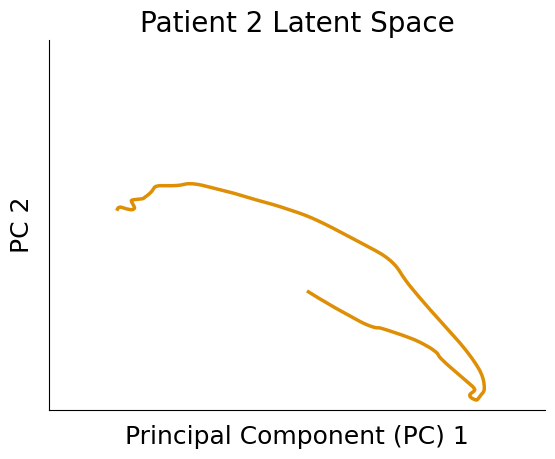

In [101]:
import plotly.express as px
import seaborn as sns
import matplotlib as mpl

pc_line_df = df_unalgn.drop(['Trial'], axis=1).groupby(['Patient', 'Time']).mean().reset_index()
# fig = px.line(pc_line_df[pc_line_df['Patient'].isin(['S4'])], x='PC1', y='PC2')
# fig.update_layout(
#     plot_bgcolor='white',
#     font=dict(size=18, family='Arial'),
#     width=500,
#     height=500,
#     title='asdf'
# )
# fig.update_xaxes(
#     title='Principal Component (PC) 1',
#     mirror=False,
#     ticks='outside',
#     tickvals=[],
#     showline=True,
#     linecolor='black',
#     showgrid=False,
#     side='bottom'
# )
# fig.update_yaxes(
#     title='PC 2',
#     mirror=False,
#     showticklabels=False,
#     showline=True,
#     linecolor='black',
#     showgrid=False,
# )
# fig.update_traces(line=dict(width=4))
# fig.show()

# mpl.rcParams['font.family'] = 'Arial'


g = sns.lineplot(data=pc_line_df[pc_line_df['Patient'].isin(['S2'])], x='PC1', y='PC2', hue='Patient', sort=False, linewidth=2.5, palette=sns.color_palette('colorblind')[1:])
sns.despine()
g.set_xticklabels([])
g.set_yticklabels([])
g.set_xlim([-0.1, 3])
g.set_ylim([-2.9, 1.5])
g.set_xlabel('Principal Component (PC) 1', fontsize=18)
g.set_ylabel('PC 2', fontsize=18)
g.tick_params(left=False, bottom=False)
g.set_title('Subject 2 Latent Space', fontsize=20)
plt.legend([],[], frameon=False)
plt.show()


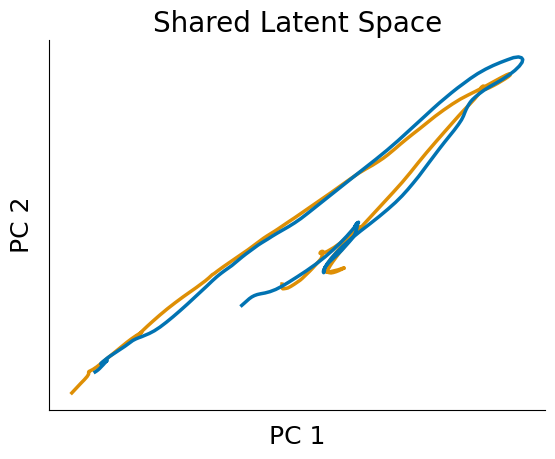

In [99]:
pc_algn_df = df_algn_S4.drop(['Trial'], axis=1).groupby(['Patient', 'Time']).mean().reset_index()
# fig = px.line(pc_algn_df[pc_algn_df['Patient'].isin(['S4', 'S2'])], x='PC1', y='PC2', color='Patient')

# fig.update_layout(
#     plot_bgcolor='white',
#     font=dict(size=18, family='Arial'),
#     width=500,
#     height=500
# )
# fig.update_xaxes(
#     title='Principal Component (PC) 1',
#     mirror=False,
#     ticks='outside',
#     tickvals=[],
#     showline=True,
#     linecolor='black',
#     showgrid=False,
#     side='bottom'
# )
# fig.update_yaxes(
#     title='PC 2',
#     mirror=False,
#     showticklabels=False,
#     showline=True,
#     linecolor='black',
#     showgrid=False,
# )
# fig.update_traces(line=dict(width=4))
# fig.show()

g = sns.lineplot(data=pc_algn_df[pc_line_df['Patient'].isin(['S4', 'S2'])], x='PC1', y='PC2', hue='Patient', sort=False, linewidth=2.5, palette=sns.color_palette('colorblind')[:2][::-1])
sns.despine()
g.set_xticklabels([])
g.set_yticklabels([])
# g.set_xlim([-0.1, 3])
# g.set_ylim([-2.9, 1.5])
g.set_xlabel('PC 1', fontsize=18)
g.set_ylabel('PC 2', fontsize=18)
g.tick_params(left=False, bottom=False)
g.set_title('Shared Latent Space', fontsize=20)
plt.legend([],[], frameon=False)
plt.show()

## Joint & Regular TSNE

In [ ]:
from sklearn.manifold import TSNE

t = np.linspace(-0.5, 0.5 - 1/S14_hg_trace.shape[1], S14_hg_trace.shape[1])
zero_ind = np.where(t == 0)[0][0]

perp = 30
tsne_comp = 2

S14_embed_t0 = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S14_joint_decomp[:,zero_ind,:])
S26_embed_t0 = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S26_joint_decomp[:,zero_ind,:])
S23_embed_t0 = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S23_joint_decomp[:,zero_ind,:])
S33_embed_t0 = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S33_joint_decomp[:,zero_ind,:])


t_pca_comp = 0.8
S14_time_pca = PCA(n_components=t_pca_comp).fit_transform(S14_joint_decomp.reshape(S14_joint_decomp.shape[0], -1))
S14_embed_time = TSNE(n_components=tsne_comp, perplexity=perp, early_exaggeration=4).fit_transform(S14_time_pca)
S26_time_pca = PCA(n_components=t_pca_comp).fit_transform(S26_joint_decomp.reshape(S26_joint_decomp.shape[0], -1))
S26_embed_time = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S26_time_pca)
S23_time_pca = PCA(n_components=t_pca_comp).fit_transform(S23_joint_decomp.reshape(S23_joint_decomp.shape[0], -1))
S23_embed_time = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S23_time_pca)
S33_time_pca = PCA(n_components=t_pca_comp).fit_transform(S33_joint_decomp.reshape(S33_joint_decomp.shape[0], -1))
S33_embed_time = TSNE(n_components=tsne_comp, perplexity=perp).fit_transform(S33_time_pca)

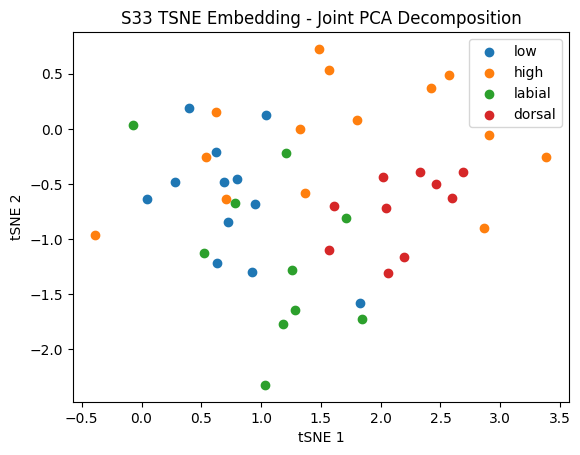

In [ ]:
data = S33_embed_time
labels = S33_artic_labels[:,0]
label_names = artic_labels

plt.figure()
for lab in np.unique(labels):
    plt.scatter(data[np.where(labels == lab)[0],0], data[np.where(labels == lab)[0],1], label=label_names[lab-1])
# plt.scatter(S14_embed_t0[:,0], S14_embed_t0[:,1], c=S14_artic_labels[:,0])
plt.xlabel('tSNE 1')
plt.ylabel('tSNE 2')
plt.title('S33 TSNE Embedding - Joint PCA Decomposition')
plt.legend()
plt.show()

# f = plt.figure()
# ax = f.add_subplot(projection='3d')
# for lab in np.unique(labels):
#     ax.scatter(data[np.where(labels == lab)[0],0], data[np.where(labels == lab)[0],1], data[np.where(labels == lab)[0],2], label=label_names[lab-1])
# # plt.scatter(S14_embed_t0[:,0], S14_embed_t0[:,1], c=S14_artic_labels[:,0])
# plt.xlabel('tSNE 1')
# plt.ylabel('tSNE 2')
# ax.set_zlabel('tSNE 3')
# plt.title('S14 TSNE Embedding - Joint PCA Decomposition')
# plt.legend()
# plt.show()

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

S14_joint_sil_scores = silhouette_samples(S14_embed_time, S14_artic_labels[:,0])
# S14_joint_sil = silhouette_score(S14_embed_time, S14_artic_labels[:,0])
print(f'S14 Joint-PCA Silhouette Score: {np.mean(S14_joint_sil_scores[np.where(S14_joint_sil_scores > 0)[0]])}')

S26_joint_sil_scores = silhouette_samples(S26_embed_time, S26_artic_labels[:,0])
# S26_joint_sil = silhouette_score(S26_embed_time, S26_artic_labels[:,0])
print(f'S26 Joint-PCA Silhouette Score: {np.mean(S26_joint_sil_scores[np.where(S26_joint_sil_scores > 0)[0]])}')

S23_joint_sil_scores = silhouette_samples(S23_embed_time, S23_artic_labels[:,0])
# S23_joint_sil = silhouette_score(S23_embed_time, S23_artic_labels[:,0])
print(f'S23 Joint-PCA Silhouette Score: {np.mean(S23_joint_sil_scores[np.where(S23_joint_sil_scores > 0)[0]])}')

S33_joint_sil_scores = silhouette_samples(S33_embed_time, S33_artic_labels[:,0])
# S33_joint_sil = silhouette_score(S33_embed_time, S33_artic_labels[:,0])
print(f'S33 Joint-PCA Silhouette Score: {np.mean(S33_joint_sil_scores[np.where(S33_joint_sil_scores > 0)[0]])}')

S14 Joint-PCA Silhouette Score: 0.18488289415836334
S26 Joint-PCA Silhouette Score: 0.22684462368488312
S23 Joint-PCA Silhouette Score: 0.06652616709470749
S33 Joint-PCA Silhouette Score: 0.33366310596466064


In [ ]:
pca_var = 0.8

##### P1 Data #####
S14_sep_pca_X = S14_hg_trace.reshape(S14_hg_trace.shape[0], -1)
S14_sep_pca = PCA(n_components=pca_var).fit_transform(S14_sep_pca_X)
S14_sep_embed = TSNE(n_components=2, perplexity=30).fit_transform(S14_sep_pca)

S26_sep_pca_X = S26_hg_trace.reshape(S26_hg_trace.shape[0], -1)
S26_sep_pca = PCA(n_components=pca_var).fit_transform(S26_sep_pca_X)
S26_sep_embed = TSNE(n_components=2, perplexity=30).fit_transform(S26_sep_pca)

S23_sep_pca_X = S23_hg_trace.reshape(S23_hg_trace.shape[0], -1)
S23_sep_pca = PCA(n_components=pca_var).fit_transform(S23_sep_pca_X)
S23_sep_embed = TSNE(n_components=2, perplexity=30).fit_transform(S23_sep_pca)

S33_sep_pca_X = S33_hg_trace.reshape(S33_hg_trace.shape[0], -1)
S33_sep_pca = PCA(n_components=pca_var).fit_transform(S33_sep_pca_X)
S33_sep_embed = TSNE(n_components=2, perplexity=30).fit_transform(S33_sep_pca)


##### Collapsed Across Positions #####
S14_coll_pca_X = S14_hg_collapsed.reshape(S14_hg_collapsed.shape[0], -1)
S14_coll_pca = PCA(n_components=pca_var).fit_transform(S14_coll_pca_X)
S14_coll_embed = TSNE(n_components=2, perplexity=30).fit_transform(S14_coll_pca)

S26_coll_pca_X = S26_hg_collapsed.reshape(S26_hg_collapsed.shape[0], -1)
S26_coll_pca = PCA(n_components=pca_var).fit_transform(S26_coll_pca_X)
S26_coll_embed = TSNE(n_components=2, perplexity=30).fit_transform(S26_coll_pca)

S23_coll_pca_X = S23_hg_collapsed.reshape(S23_hg_collapsed.shape[0], -1)
S23_coll_pca = PCA(n_components=pca_var).fit_transform(S23_coll_pca_X)
S23_coll_embed = TSNE(n_components=2, perplexity=30).fit_transform(S23_coll_pca)

S33_coll_pca_X = S33_hg_collapsed.reshape(S33_hg_collapsed.shape[0], -1)
S33_coll_pca = PCA(n_components=pca_var).fit_transform(S33_coll_pca_X)
S33_coll_embed = TSNE(n_components=2, perplexity=30).fit_transform(S33_coll_pca)

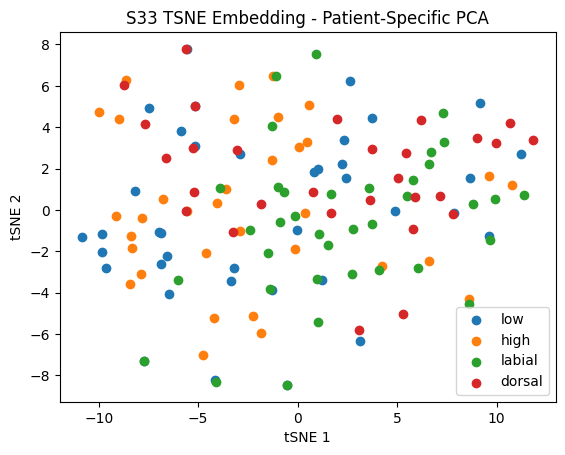

In [ ]:
data = S33_coll_embed
labels = S33_artic_labels_collapsed
# labels = S33_artic_labels[:,0]
label_names = artic_labels

plt.figure()
for lab in np.unique(labels):
    plt.scatter(data[np.where(labels == lab)[0],0], data[np.where(labels == lab)[0],1], label=label_names[lab-1])
plt.xlabel('tSNE 1')
plt.ylabel('tSNE 2')
plt.title('S33 TSNE Embedding - Patient-Specific PCA')
plt.legend()
plt.show()

# f = plt.figure()
# ax = f.add_subplot(projection='3d')
# for lab in np.unique(labels):
#     ax.scatter(data[np.where(labels == lab)[0],0], data[np.where(labels == lab)[0],1], data[np.where(labels == lab)[0],2], label=label_names[lab-1])
# # plt.scatter(S14_embed_t0[:,0], S14_embed_t0[:,1], c=S14_artic_labels[:,0])
# plt.xlabel('tSNE 1')
# plt.ylabel('tSNE 2')
# ax.set_zlabel('tSNE 3')
# plt.title('S14 TSNE Embedding - Patient-Specific PCA')
# plt.legend()
# plt.show()

In [ ]:
from sklearn.metrics import silhouette_score, silhouette_samples

S14_sep_sil_scores = silhouette_samples(S14_sep_embed, S14_artic_labels[:,0])
# S14_sep_sil = silhouette_score(S14_sep_embed, S14_artic_labels[:,0])
print(f'S14 PS-PCA Silhouette Score: {np.mean(S14_sep_sil_scores[np.where(S14_sep_sil_scores > 0)[0]])}')

S26_sep_sil_scores = silhouette_samples(S26_sep_embed, S26_artic_labels[:,0])
# S26_sep_sil = silhouette_score(S26_sep_embed, S26_artic_labels[:,0])
print(f'S26 PS-PCA Silhouette Score: {np.mean(S26_sep_sil_scores[np.where(S26_sep_sil_scores > 0)[0]])}')

S23_sep_sil_scores = silhouette_samples(S23_sep_embed, S23_artic_labels[:,0])
# S23_sep_sil = silhouette_score(S23_sep_embed, S23_artic_labels[:,0])
print(f'S23 PS-PCA Silhouette Score: {np.mean(S23_sep_sil_scores[np.where(S23_sep_sil_scores > 0)[0]])}')

S33_sep_sil_scores = silhouette_samples(S33_sep_embed, S33_artic_labels[:,0])
# S33_sep_sil = silhouette_score(S33_sep_embed, S33_artic_labels[:,0])
print(f'S33 PS-PCA Silhouette Score: {np.mean(S33_sep_sil_scores[np.where(S33_sep_sil_scores > 0)[0]])}')

S14 PS-PCA Silhouette Score: 0.3364023268222809
S26 PS-PCA Silhouette Score: 0.1526738405227661
S23 PS-PCA Silhouette Score: 0.16618718206882477
S33 PS-PCA Silhouette Score: 0.2860357463359833
